In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# gpu_info = !nvidia-smi
# gpu_info = '\n'.join(gpu_info)
# if gpu_info.find('failed') >= 0:
#   print('Not connected to a GPU')
# else:
#   print(gpu_info)

Thu Nov 14 20:14:29 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   42C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
# from psutil import virtual_memory
# ram_gb = virtual_memory().total / 1e9
# print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

# if ram_gb < 20:
#   print('Not using a high-RAM runtime')
# else:
#   print('You are using a high-RAM runtime!')

Your runtime has 13.6 gigabytes of available RAM

Not using a high-RAM runtime


In [ ]:
base_path = "/content/drive/MyDrive/Medical Data"
EDA = "/content/drive/MyDrive/Medical Data/EDA"
pre_processing = "drive/MyDrive/Medical Data/PreProcessing/"

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import h5py
from tqdm import tqdm

In [ ]:
def convert_npz_to_hdf5(npz_path, hdf5_path):
    """
    Convert an NPZ file to HDF5 format.

    The function reads data from an NPZ file and writes it to an HDF5 file,
    making the data more accessible for applications that work with large datasets.

    Parameters:
    - npz_path (str): Path to the source NPZ file.
    - hdf5_path (str): Path to the destination HDF5 file.

    Returns:
    None
    """
    # Load the NPZ file in read mode
    data = np.load(npz_path, mmap_mode='r', allow_pickle=False)

    # Create or open the HDF5 file in write mode
    with h5py.File(hdf5_path, 'w') as f:
        for key in data.keys():
            # If the data is image data, handle its large size and memory requirements appropriately
            if key == 'image':
                num_images, height, width, channels = data['image'].shape
                print(f"Converting {num_images} images...")

                # Create a dataset for images in the HDF5 file with float16 precision
                images_dset = f.create_dataset('image', (num_images, height, width, channels), dtype=np.float16)

                # Convert images in chunks to manage memory consumption
                chunk_size = 1000  # Adjust as needed
                for start_idx in tqdm(range(0, num_images, chunk_size), desc="Converting images"):
                    end_idx = start_idx + chunk_size
                    images_dset[start_idx:end_idx] = data['image'][start_idx:end_idx].astype(np.float16)
            # If the data is image names, handle strings by encoding to utf-8
            elif key == 'image_name':
                str_data = [s.item().encode('utf-8') for s in data[key].flatten()]

                # Use a special datatype in HDF5 to handle variable-length strings
                dt = h5py.special_dtype(vlen=str)
                f.create_dataset(key, (len(str_data),), dtype=dt, data=str_data)
            # For all other data, just write it directly to the HDF5 file
            else:
                f.create_dataset(key, data=data[key])

    print("Conversion complete!")

In [ ]:
#convert_npz_to_hdf5(f'{base_path}/Dataset5_raw_train.npz', f'{base_path}/Dataset5_raw_train.h5')

In [ ]:
#convert_npz_to_hdf5(f'{base_path}/Dataset5_raw_test.npz', f'{base_path}/Dataset5_raw_test.h5')


In [ ]:
#convert_npz_to_hdf5(f'{base_path}/Dataset5_raw_val.npz', f'{base_path}/Dataset5_raw_val.h5')


In [ ]:
def load_hdf5_data(hdf5_path):
    f = h5py.File(hdf5_path, 'r')
    return f['image'], f['image_name'], f['image_label']

train_images, train_names, train_labels = load_hdf5_data(f'{base_path}/Dataset5_raw_train.h5')
val_images, val_names, val_labels = load_hdf5_data(f'{base_path}/Dataset5_raw_val.h5')
test_images, test_names, test_labels = load_hdf5_data(f'{base_path}/Dataset5_raw_test.h5')

In [ ]:
print(f"train_images shape : {train_images.shape} and train_labels shape : {train_labels.shape}")
print(f"val_images shape : {val_images.shape} and train_labels shape : {val_labels.shape}")
print(f"test_images shape : {test_images.shape} and train_labels shape : {test_labels.shape}")

train_images shape : (19610, 224, 224, 3) and train_labels shape : (19610, 1)
val_images shape : (6534, 224, 224, 3) and train_labels shape : (6534, 1)
test_images shape : (6540, 224, 224, 3) and train_labels shape : (6540, 1)


In [ ]:
np.array(train_names) , np.array(train_labels)

(array([b'11547_2020_1203_Fig2_HTML-c.png', b'COVID-3569.png',
        b'COVID-2032.png', ..., b'CXR1519_IM-0335-4004.png',
        b'CXR757_IM-2308-1001.png', b'CXR1459_IM-0297-1001.png'],
       dtype=object),
 array([[0.],
        [0.],
        [0.],
        ...,
        [4.],
        [4.],
        [4.]]))

In [ ]:
train_images.shape , np.array(train_images).dtype , np.array(train_labels).shape, train_names.shape , np.array(train_labels.dtype), train_names.dtype

((19610, 224, 224, 3),
 dtype('<f2'),
 (19610, 1),
 (19610,),
 array(dtype('<f8'), dtype=object),
 dtype('O'))

In [ ]:
train_images

<HDF5 dataset "image": shape (19610, 224, 224, 3), type "<f2">

In [ ]:
"""
COVID-19 :  4,189 : 0
Lung-Opacity : 6,012 : 1
Normal : 10,192 : 2
Viral Pneumonia : 7,397 : 3
Tuberculosis : 4,897 : 4
"""

Label_ClassName_Dict = {
    0 : "COVID-19",
    1 : "Lung-Opacity",
    2 : "Normal",
    3 : "Viral Pneumonia",
    4 : "Tuberculosis",
}

In [ ]:
# 1. Distribution of classes in training, testing, and validation sets
def plot_class_distribution(labels, Type = "Training" , Path = f"{EDA}/Train_Value_Counts.png"):
    labels_series = pd.Series(np.array(labels).squeeze())
    # print(labels_series)

    classes = labels_series.unique()
    values = []
    for i in classes:
      values.append(labels_series.value_counts()[i])
    print(values)

    sns.set(style="whitegrid")  # Set the style of the plot (optional)
    plt.figure(figsize=(10, 6))  # Set the size of the plot (optional)

    class_names = [Label_ClassName_Dict[class_id] for class_id in classes]  # Get class names from the dictionary

    ax = sns.barplot(x=class_names, y=values)
    plt.ylabel("Number of Samples")
    plt.xlabel("Class Label")
    plt.title(f'Number of Samples Belonging to Each Infectious Disease Class in Chest Radiological Images {Type} Dataset.')
    # Add the actual number of samples above each bar
    for i, v in enumerate(values):
        ax.text(i, v + 5, str(v), ha='center', va='bottom', fontsize=10)

    plt.xticks(rotation=45, ha="right")  # Rotate x-axis labels for better readability
    plt.tight_layout()  # Prevent labels from being cut off
    plt.savefig(Path)
    plt.show()

# 2. Average pixel intensity distribution
def plot_pixel_intensity(images, Path=f"{EDA}/Train_pixel_intensity.png" , Type = "Training"):
    plt.hist(np.array(images).mean(axis=(1, 2, 3)), bins=30, label=f'{Type}')
    # plt.hist(test_images.mean(axis=(1, 2, 3)), bins=30, label='Test')
    # plt.hist(val_images.mean(axis=(1, 2, 3)), bins=30, label='Validation')
    plt.legend()
    plt.title(f'Pixel Intensity Distribution of {Type} Dataset.')
    plt.savefig(Path)
    plt.show()

# 3. Size distribution of the images
def plot_image_size(images, Path=f"{EDA}/Train_img_size_dist.png", Type="Training"):
    images = np.array(images)
    image_heights = [img.shape[0] for img in images]
    image_widths = [img.shape[1] for img in images]

    plt.figure(figsize=(8, 6))
    plt.hist2d(image_widths, image_heights, bins=30, cmap='Blues')
    plt.colorbar(label='Frequency')
    plt.xlabel('Image Width')
    plt.ylabel('Image Height')
    plt.title(f'Image Size Distribution of {Type} Dataset')
    plt.savefig(Path)
    plt.show()



# 4. Show some samples of each class
def display_samples(images, labels, num_samples=5, Path=f"{EDA}/Samples_Train.png", Type="Training"):
    plt.figure(figsize=(15, 5))
    for i in range(num_samples):
        print(labels[i])
        ax = plt.subplot(1, num_samples, i + 1)
        image = images[i]
        # Normalize the image if its values are not in the range [0, 1]
        # Convert the image to a suitable dtype
        if image.max() > 1:
            image = (image / 255.0).astype(np.float32)
        else:
            image = image.astype(np.float32)

        plt.imshow(image, cmap='gray' if len(image.shape) == 2 else None) # Use gray colormap if the image is grayscale
        plt.title(f'Class: {labels[i]}\n' + f'Class Name : {Label_ClassName_Dict[int(labels[i].squeeze())]}\n' + f"{image.shape}")
        plt.axis('off')

    plt.suptitle(f"{Type} Samples")
    plt.tight_layout()
    plt.savefig(Path)
    plt.show()

# 5. Check if any images are duplicated across the datasets
# def check_duplicates():
#     all_images = np.vstack([test_images, val_images])
#     unique_images, counts = np.unique(all_images, axis=0, return_counts=True)
#     duplicates = unique_images[counts > 1]
#     print(f"Number of duplicated images: {len(duplicates)}")

# 6. Check for missing values (if any)
def has_missing_value(image):
    return np.isnan(image).any()

def count_images_with_missing_values(images):
    images = np.array(images)
    num_images = images.shape[0]
    vectorized_has_missing_value = np.vectorize(has_missing_value, signature='(h,w,c)->()')
    num_missing_values = vectorized_has_missing_value(images).sum()
    return num_missing_values, num_images


# 7. Distribution of image intensities for each class
def plot_intensity_per_class(images, labels, Path="intensity_per_class.png", Type = "Training"):
    classes = [0, 1, 2, 3, 4]

    # Set the style of the plot
    sns.set_style("whitegrid")

    # Use a custom color palette
    colors = sns.color_palette("cubehelix", len(classes))

    fig, axs = plt.subplots(2, 5, figsize=(20, 10))

    images = np.array(images)
    labels = np.array(labels)
    bins = np.linspace(images.min(), images.max(), 30)  # common bin edges for all classes

    # For Side-by-Side Histograms with KDE
    for idx, cls in enumerate(classes):
        ax = axs[0, idx]

        class_mask = labels.squeeze() == cls
        class_image_indices = np.where(class_mask)[0]
        class_intensities = images[class_image_indices].mean(axis=(1, 2, 3))

        # Assign color from the palette
        sns.histplot(class_intensities, bins=bins, kde=True, ax=ax, label=f'Class {cls}', color=colors[idx])

        ax.set_title(f'Class {Label_ClassName_Dict[int(cls)]}') # Assuming you have a dictionary named Label_ClassName_Dict
        ax.set_xlabel('Mean Intensity')
        if idx == 0:
            ax.set_ylabel('Frequency')

    # For Box Plots
    all_intensities = [images[labels.squeeze() == cls].mean(axis=(1, 2, 3)) for cls in classes]
    for idx, class_intensities in enumerate(all_intensities):
        ax = axs[1, idx]

        # Assign color from the palette
        sns.boxplot(y=class_intensities, ax=ax, color=colors[idx])

        ax.set_title(f'Class {Label_ClassName_Dict[int(classes[idx])]}') # Assuming you have a dictionary named Label_ClassName_Dict
        ax.set_xlabel('Mean Intensity')
        if idx == 0:
            ax.set_ylabel('Intensity Distribution')
    plt.suptitle(f"{Type}")
    plt.tight_layout()
    plt.savefig(Path)
    plt.show()

# 10. Correlation between different classes - Not applicable as the classes are categorical

[2512, 3607, 6115, 4438, 2938]


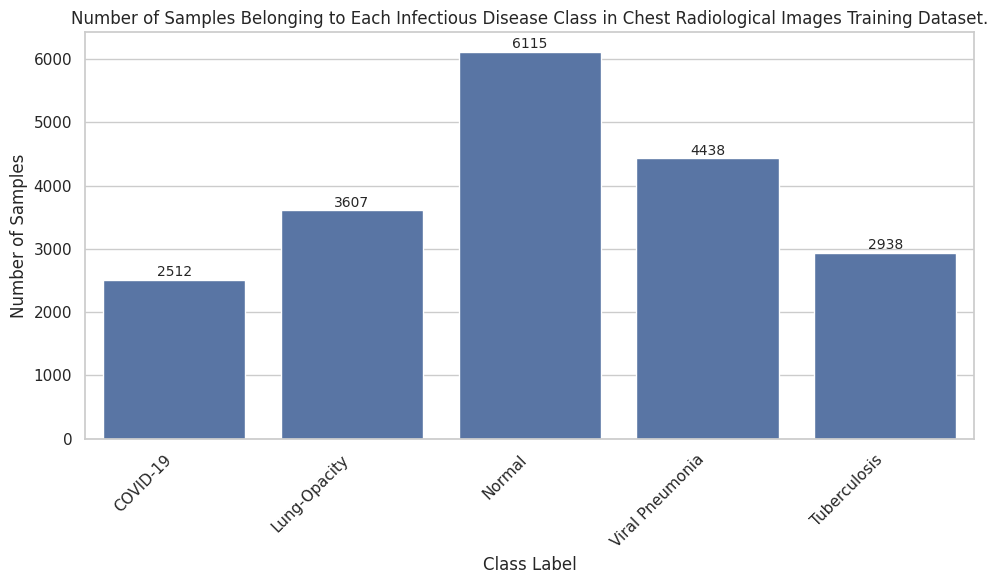

In [ ]:
plot_class_distribution(train_labels)

[836, 1202, 2038, 1479, 979]


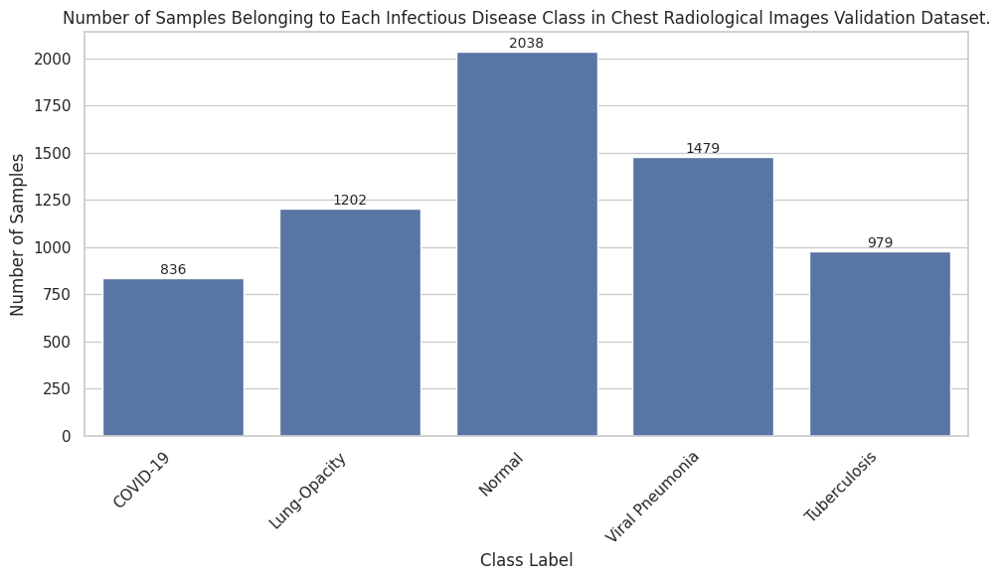

In [ ]:
plot_class_distribution(val_labels, Type = "Validation" , Path = f"{EDA}/Val_Value_Counts.png")

[838, 1203, 2039, 1480, 980]


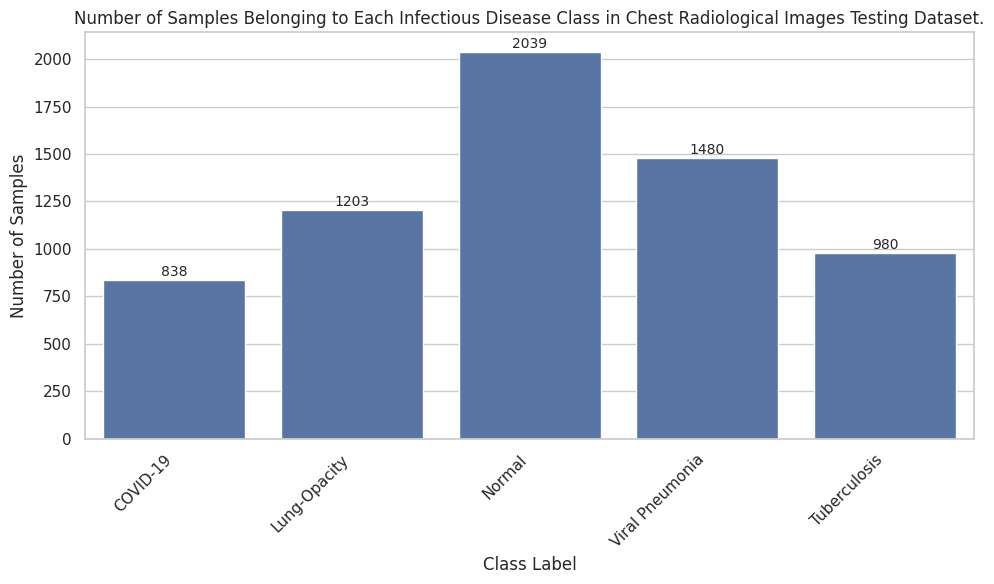

In [ ]:
plot_class_distribution(test_labels, Type = "Testing" , Path = f"{EDA}/Test_Value_Counts.png")

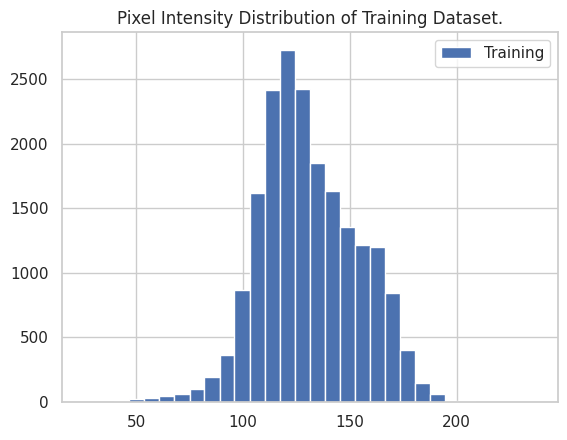

In [ ]:
plot_pixel_intensity(train_images)

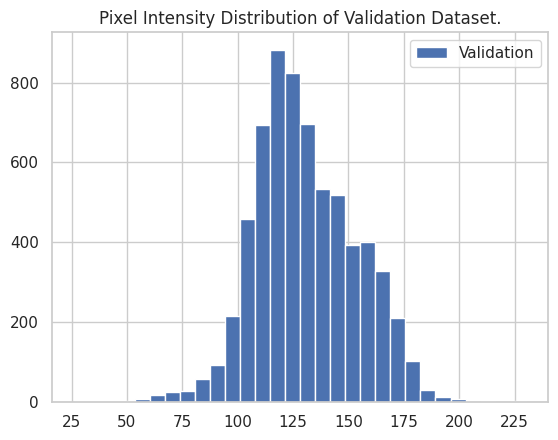

In [ ]:
plot_pixel_intensity(val_images, Path=f"{EDA}/val_pixel_intensity.png" , Type = "Validation")

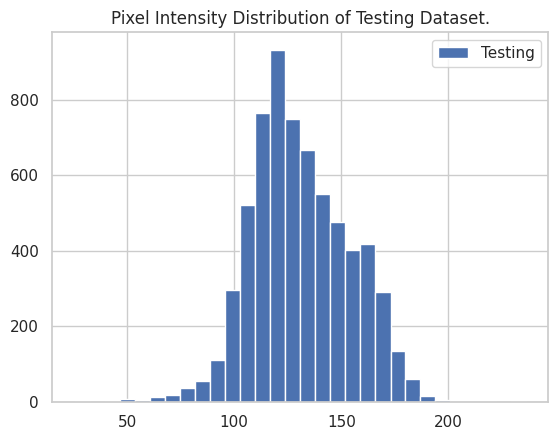

In [ ]:
plot_pixel_intensity(test_images, Path=f"{EDA}/test_pixel_intensity.png" , Type = "Testing")

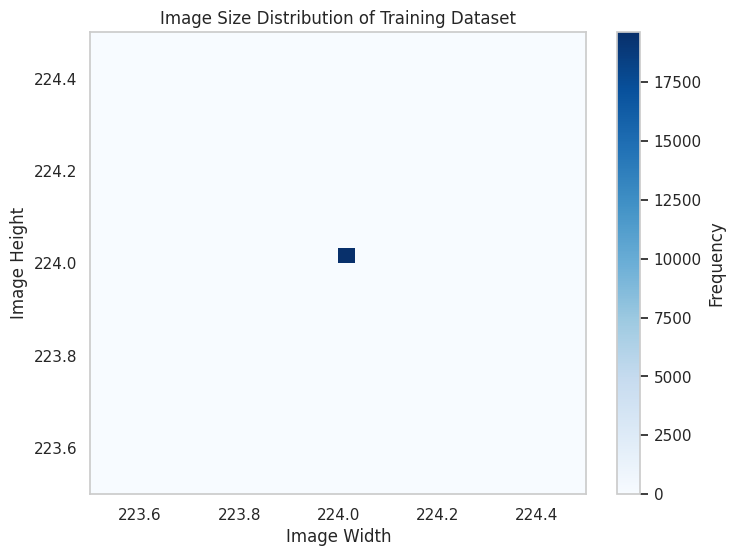

In [ ]:
# Assuming 'train_images' is the image dataset.
plot_image_size(train_images)

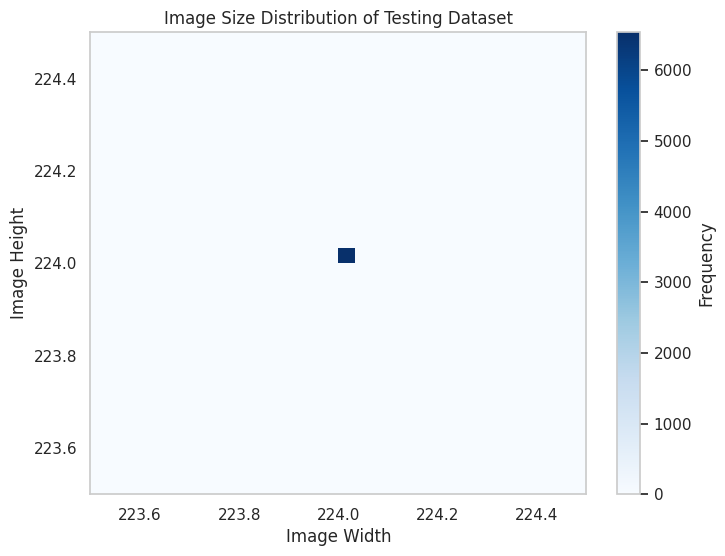

In [ ]:
plot_image_size(test_images, Path=f"{EDA}/Test_img_size_dist.png", Type="Testing")

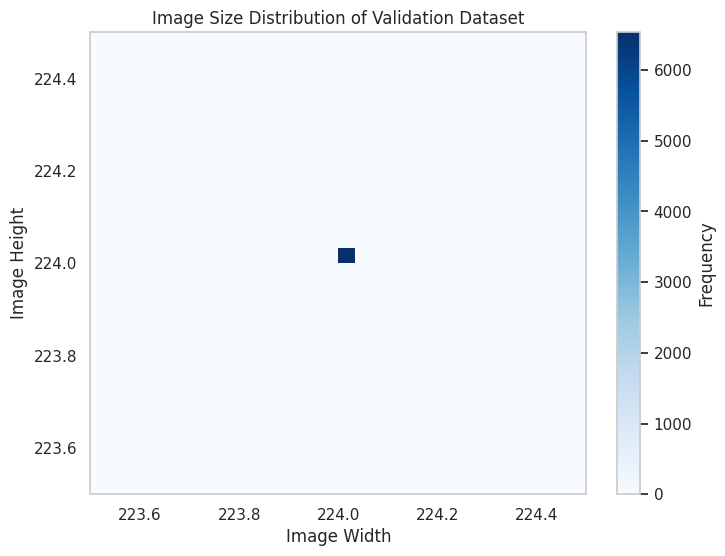

In [ ]:
plot_image_size(val_images, Path=f"{EDA}/Val_img_size_dist.png", Type="Validation")

[0.]
[0.]
[0.]
[0.]
[0.]


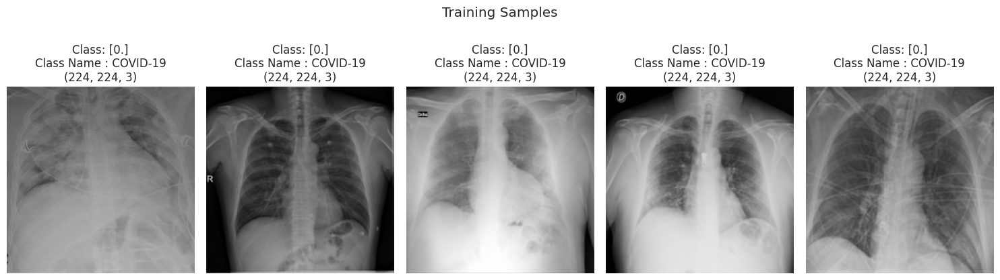

In [ ]:
# Display some train samples
display_samples(train_images, train_labels)

[0.]
[0.]
[0.]
[0.]
[0.]


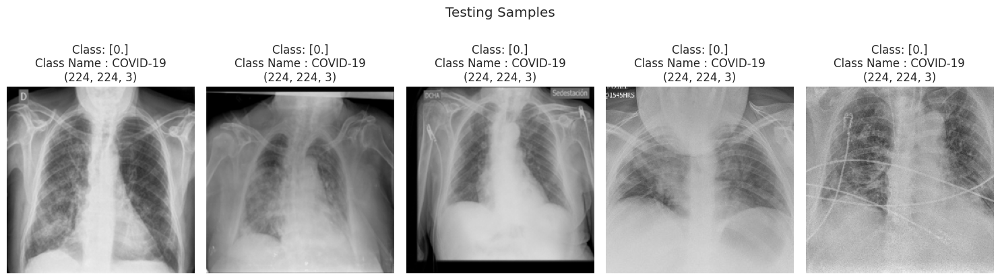

In [ ]:
display_samples(test_images, test_labels, num_samples=5, Path=f"{EDA}/Samples_Test.png", Type="Testing")

[0.]
[0.]
[0.]
[0.]
[0.]


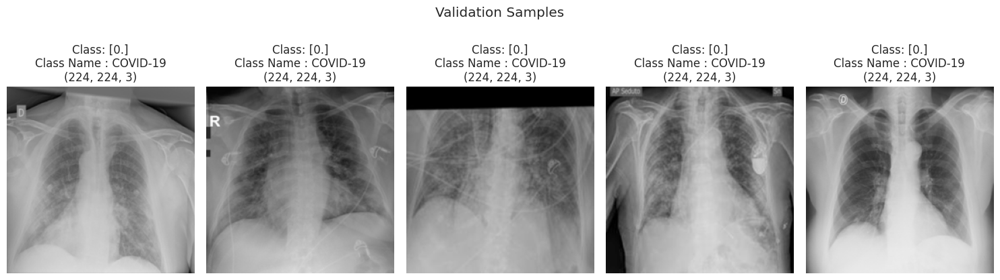

In [ ]:
display_samples(val_images, val_labels, num_samples=5, Path=f"{EDA}/Samples_Val.png", Type="Validation")

In [ ]:
# Assuming 'images' is your ndarray with shape (19610, 224, 224, 3)
num_missing_values, num_images = count_images_with_missing_values(train_images)
print(f"Total missing values in images: {num_missing_values}")
print(f"Total images processed: {num_images}")

Total missing values in images: 0
Total images processed: 19610


In [ ]:
num_missing_values, num_images = count_images_with_missing_values(test_images)
print(f"Total missing values in images: {num_missing_values}")
print(f"Total images processed: {num_images}")

Total missing values in images: 0
Total images processed: 6540


In [ ]:
num_missing_values, num_images = count_images_with_missing_values(val_images)
print(f"Total missing values in images: {num_missing_values}")
print(f"Total images processed: {num_images}")

Total missing values in images: 0
Total images processed: 6534


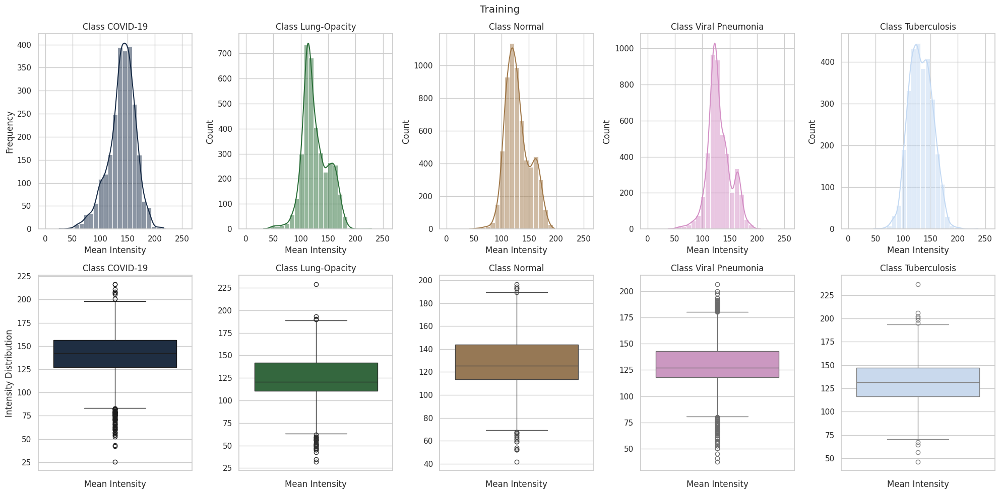

In [ ]:
plot_intensity_per_class(train_images, train_labels)

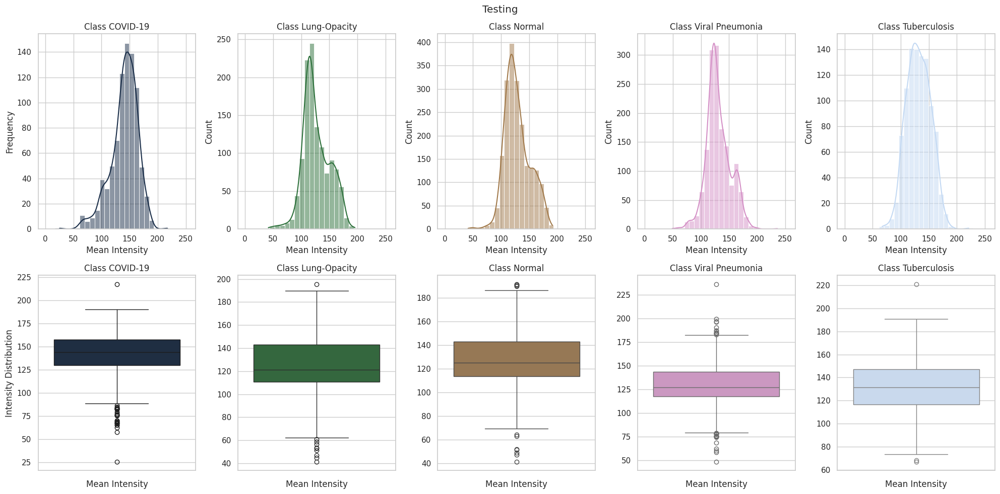

In [ ]:
plot_intensity_per_class(test_images, test_labels, Path="intensity_per_class_testing.png", Type = "Testing")

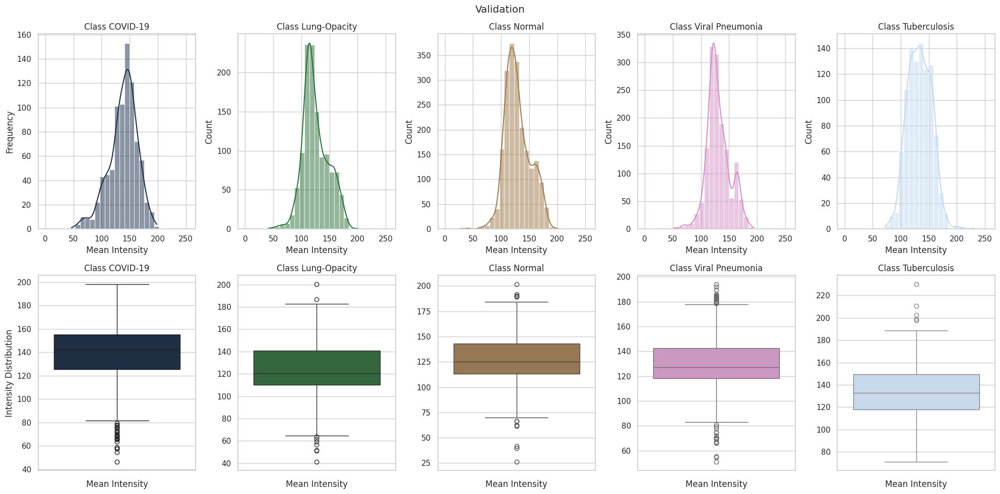

In [ ]:
plot_intensity_per_class(val_images, val_labels, Path="intensity_per_class_val.png", Type = "Validation")

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Flatten, Conv2D, MaxPooling2D, LSTM, Dropout, concatenate

In [ ]:
# Step 2: Define CNN for image data
def create_cnn(input_shape):
    cnn_input = Input(shape=input_shape)
    x = Conv2D(32, (3, 3), activation='relu')(cnn_input)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Conv2D(64, (3, 3), activation='relu')(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Conv2D(128, (3, 3), activation='relu')(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Flatten()(x)
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.5)(x)
    return Model(inputs=cnn_input, outputs=x)


In [ ]:
# Step 3: Define LSTM for sequential data
def create_lstm(input_shape):
    lstm_input = Input(shape=input_shape)
    x = LSTM(64, return_sequences=True)(lstm_input)
    x = LSTM(64)(x)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.5)(x)
    return Model(inputs=lstm_input, outputs=x)

In [ ]:
# Step 4: Combine CNN and LSTM to create hybrid model
def create_hybrid_model(cnn_shape, lstm_shape):
    cnn_model = create_cnn(cnn_shape)
    lstm_model = create_lstm(lstm_shape)
    combined = concatenate([cnn_model.output, lstm_model.output])
    x = Dense(128, activation='relu')(combined)
    x = Dropout(0.5)(x)
    output = Dense(1, activation='sigmoid')(x)  # For binary classification
    model = Model(inputs=[cnn_model.input, lstm_model.input], outputs=output)
    return model

In [ ]:
# Step 5: Compile the model
cnn_shape = (128, 128, 3)  # Update to match your data
lstm_shape = (100, 1)      # Update to match your data
model = create_hybrid_model(cnn_shape, lstm_shape)
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [ ]:
# Assuming 'filename.h5' is the name of your HDF5 file
import h5py

with h5py.File('/content/drive/MyDrive/Medical Data/Dataset5_raw_train.h5', 'r') as hdf:  # Open the file in read mode
    print(hdf.keys())  # Access keys while the file is open


<KeysViewHDF5 ['image', 'image_label', 'image_name']>


In [ ]:
# Load training data
with h5py.File('/content/drive/MyDrive/Medical Data/Dataset5_raw_train.h5', 'r') as hdf:
    X_image_train = np.array(hdf['image'])       # Replace 'image' with the dataset name
    X_sequence_train = np.array(hdf['image_label']) # Replace 'sequence' with the dataset name
    y_train = np.array(hdf['image_name'])            # Replace 'labels' with the dataset name


In [ ]:
# Assuming 'filename.h5' is the name of your HDF5 file
import h5py

with h5py.File('/content/drive/MyDrive/Medical Data/Dataset5_raw_val.h5', 'r') as hdf:  # Open the file in read mode
    print(hdf.keys())  # Access keys while the file is open


<KeysViewHDF5 ['image', 'image_label', 'image_name']>


In [ ]:
# Load validation data
with h5py.File('/content/drive/MyDrive/Medical Data/Dataset5_raw_val.h5', 'r') as hdf:
    X_image_val = np.array(hdf['image'])
    X_sequence_val = np.array(hdf['image_label'])
    y_val = np.array(hdf['image_name'])

In [ ]:
# Load testing data
with h5py.File('/content/drive/MyDrive/Medical Data/Dataset5_raw_test.h5', 'r') as hdf:
    X_image_test = np.array(hdf['image'])
    X_sequence_test = np.array(hdf['image_label'])
    y_test = np.array(hdf['image_name'])

In [ ]:
X_image = X_image_train
X_sequence = X_sequence_train
y = y_train


In [ ]:
cnn_shape = (224, 224, 3)  # Update to match your image data shape
lstm_shape = (100, 1)      # Keep this as it is or update based on your sequence data

# Create the hybrid model with the updated shape
model = create_hybrid_model(cnn_shape, lstm_shape)


In [ ]:
# Create the hybrid model with the appropriate input shapes
cnn_shape = (224, 224, 3)  # Adjust to your actual image shape
lstm_shape = (100, 1)      # Adjust to your actual sequence data shape
model = create_hybrid_model(cnn_shape, lstm_shape)

In [ ]:
# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [ ]:
import tensorflow as tf

# Resize all images to 224x224
X_image_resized = tf.image.resize(X_image, [224, 224])


In [ ]:
print("X_image_resized shape:", X_image_resized.shape)  # Should be (num_samples, 224, 224, 3)
print("X_sequence shape:", X_sequence.shape)            # Should be (num_samples, sequence_length, features)
print("y shape:", y.shape)                              # Should be (num_samples,)


X_image_resized shape: (19610, 224, 224, 3)
X_sequence shape: (19610, 1)
y shape: (19610,)


In [ ]:
# Compile the model with eager mode for debugging
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'], run_eagerly=True)


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import h5py
from tqdm import tqdm
import cv2
import gc

# Importing Deep learning Libraries
import tensorflow as tf
print(tf.__version__)
from tensorflow import keras

from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential, load_model, Model
from keras.layers import (InputLayer, BatchNormalization, Dropout, Flatten,
                                     Dense, Activation, MaxPool2D, GlobalAveragePooling2D,
                                     Conv2D, MaxPooling2D)
from keras.callbacks import EarlyStopping, ModelCheckpoint, LearningRateScheduler, Callback, ReduceLROnPlateau
from keras import optimizers, Input
from keras.utils import plot_model
from keras.applications.imagenet_utils import decode_predictions
from keras.optimizers import Adam, RMSprop
from keras.metrics import Precision, Recall, AUC
from keras.backend import clear_session

# Pretrained model preprocess
from keras.applications.vgg19 import preprocess_input as vgg19_preprocess
from keras.applications.inception_v3 import preprocess_input as inception_preprocess
from keras.applications.xception import preprocess_input as xception_preprocess
from keras.applications.resnet import preprocess_input as resnet50_preprocess

# Pretrained models
from keras.applications.xception import Xception
from keras.applications.inception_v3 import InceptionV3
from keras.applications.vgg19 import VGG19
from keras.applications.resnet import ResNet50


# Image read and show
import skimage.io
from skimage.io import imread, imshow

# Metrics
from sklearn.metrics import f1_score , recall_score, accuracy_score, precision_score, confusion_matrix
from sklearn.metrics import roc_curve, auc, classification_report
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from itertools import cycle

2.15.0


In [ ]:
"""
CLAHE
"""

# Function to apply CLAHE
def apply_clahe(img, grid_size=15, clip_limit=2.0):
    img = img.numpy()  # Convert tensor to numpy array
    img = img.astype(np.uint8)
    grid_size = int(grid_size)
    clahe = cv2.createCLAHE(clipLimit=float(clip_limit), tileGridSize=(grid_size, grid_size))
    img_clahe = np.zeros_like(img)
    for channel in range(3):
        img_clahe[..., channel] = clahe.apply(img[..., channel])
    return img_clahe

"""
Image Shapening
"""

# kernels = [[[ 0,-1, 0],[-1, 5,-1],[ 0,-1, 0]], # Basic Sharpening Kernel:
#            [[ 0, 1, 0],[ 1,-4, 1],[ 0, 1, 0]], # Laplacian Sharpening Kernel:
#            [[-1, 0,-1],[ 0, 8, 0],[-1, 0,-1]], # Diagonal Edge Sharpening:
#            [[-1,-1,-1],[-1, 9,-1],[-1,-1,-1]], # Exaggerated Sharpening:
#            [[ 1, 1, 1],[ 1,-7, 1],[ 1, 1, 1]], # Another variant of Laplacian:
# ]

kernels = {
    "Basic Sharpening Kernel" : np.array([[ 0,-1, 0],[-1, 5,-1],[ 0,-1, 0]]),
    "Laplacian Sharpening Kernel" : np.array([[ 0, 1, 0],[ 1,-4, 1],[ 0, 1, 0]]),
    "Diagonal Edge Sharpening" : np.array([[-1, 0,-1],[ 0, 8, 0],[-1, 0,-1]]) ,
    "Exaggerated Sharpening" : np.array([[-1,-1,-1],[-1, 9,-1],[-1,-1,-1]]),
    "Another variant of Laplacian" : np.array([[ 1, 1, 1],[ 1,-7, 1],[ 1, 1, 1]],) ,
}

# Function to sharpen image
def sharpen_image(img, kernel= kernels["Basic Sharpening Kernel"]):
    img = img.numpy()
    img = img.astype(np.uint8)
    kernel = np.array(kernel)
    return cv2.filter2D(img, -1, kernel)


"""
Zoom Function - Handling Noise and Other Artifacts in the Dataset

1. Cropping / Zoom
2. Data Augmentation
3. Add Noise to the Images
"""

def zoom_into_chest_area(img, zoom_factor=0.83):
    """
    Zooms into the central region of a given X-ray image (assuming the chest area is centrally located).

    Args:
    - img_np: A numpy ndarray representing the X-ray image.
    - zoom_factor: Factor by which to zoom into the image. Values less than 1 zoom in.

    Returns:
    - A numpy ndarray representing the zoomed image.
    """
    img_np = img.numpy().copy().astype("uint8")
    if not isinstance(img_np, np.ndarray):
        raise ValueError("Input image must be a numpy ndarray.")

    # Calculate the dimensions of the portion to zoom into
    center_x, center_y = img_np.shape[1] // 2, img_np.shape[0] // 2
    width_zoomed = img_np.shape[1] * zoom_factor
    height_zoomed = img_np.shape[0] * zoom_factor

    # Define ROI boundaries
    x1 = int(center_x - width_zoomed // 2)
    x2 = int(center_x + width_zoomed // 2)
    y1 = int(center_y - height_zoomed // 2)
    y2 = int(center_y + height_zoomed // 2)

    # Extract the region of interest from the image
    zoomed_roi = img_np[y1:y2, x1:x2]

    # Resize the ROI to the original image dimensions
    zoomed_img = cv2.resize(zoomed_roi, (img_np.shape[1], img_np.shape[0]))

    return zoomed_img

def crop_and_resize_image_np(img, crop_percentage=0.1):
    """
    Crops and then resizes a given image using numpy and OpenCV.

    Args:
    - img_np: A numpy ndarray representing the image.
    - crop_percentage: Percentage of the image's height to crop from each side.

    Returns:
    - A numpy ndarray representing the cropped and resized image.
    """

    img_np = img.numpy().copy().astype("uint8")
    if not isinstance(img_np, np.ndarray):
        raise ValueError("Input image must be a numpy ndarray.")

    # Calculate the dimensions of the portion to crop
    height, width = img_np.shape[0], img_np.shape[1]

    # Calculate crop size
    crop_size = int(height * crop_percentage)

    # Get the coordinates to crop the image
    x1, x2 = crop_size, width - crop_size
    y1, y2 = crop_size, height - crop_size

    # Crop the image
    cropped_img = img_np[y1:y2, x1:x2]

    # Resize the cropped image to the original dimensions
    resized_img = cv2.resize(cropped_img, (width, height))

    return resized_img

def add_noise_np(img, stddev=0.1):
    """
    Adds Gaussian noise to a given numpy image.

    Args:
    - img_np: A numpy ndarray representing the image.
    - stddev: Standard deviation of the Gaussian noise.

    Returns:
    - A numpy ndarray representing the image with added noise.
    """
    img_np = img.numpy().copy().astype(np.uint8)
    if not isinstance(img_np, np.ndarray):
        raise ValueError("Input image must be a numpy ndarray.")

    # Ensure the image is in float32 for the noise addition
    img_float = img_np.astype(np.float32)

    # Create noise and add to the image
    noise = np.random.normal(loc=0, scale=stddev, size=img_np.shape)
    noisy_img = img_float + noise

    # Clip values to [0, 255] if your image has pixel values in that range
    noisy_img_clipped = np.clip(noisy_img, 0, 255)

    # Convert back to uint8
    noisy_img_uint8 = noisy_img_clipped.astype(np.uint8)

    return noisy_img_uint8


"""
Pre-Process and Visualisation Functions
"""

# Apply CLAHE, zoom, and then sharpening transformations to images
def preprocess_images(image, label):
    image = tf.py_function(zoom_into_chest_area, [image], tf.uint8)
    image = tf.py_function(apply_clahe, [image], tf.uint8)
    image = tf.py_function(sharpen_image, [image], tf.uint8)
    return image, label

# Apply CLAHE only to images
def preprocess_images_clahe(image, label, grid_size=15, clip_limit=2.0):
    image = tf.py_function(apply_clahe, [image, grid_size, clip_limit], tf.uint8)
    return image, label

# Apply sharpening transformations only to images
def preprocess_images_sharpen(image, label, kernel):
    image = tf.py_function(sharpen_image, [image, kernel], tf.uint8)
    return image, label

# Visualization function
def visualize_dataset(ds, title, path):
    samples = ds.take(5)
    # print(len(list(samples)))

    plt.figure(figsize=(15, 5))
    i = 0
    for image, label in samples:
        # print(int(label.numpy().squeeze()), label.numpy().shape , len(label.numpy()))
        # print(type(image), image.shape, len(image))
        #image = tf.image.convert_image_dtype(image, dtype=tf.uint8)
        image = image.numpy()
        if image.max() > 1:
            image = (image / 255.0).astype(np.float32)
        else:
            image = image.astype(np.float32)
        # print(image.dtype, image.min(), image.max(), image.shape, len(image.shape))
        plt.subplot(1, 5, i+1)
        plt.imshow(image)
        plt.title(f"Label: {Label_ClassName_Dict[int(label.numpy().squeeze())]}")
        plt.axis('off')
        i += 1
    plt.suptitle(title)
    plt.tight_layout()
    plt.savefig(path)
    plt.show()

def visualize(dataset, factors, process_function, sup_title):
    """
    Visualize the images after applying a processing function (zoom or crop_and_resize).
    Args:
    - dataset: A tf.data.Dataset containing the images.
    - factors: A list of factors/percentages to use with the processing function.
    - process_function: The function to process the images.
    - sup_title: The title to add above the visualized images.
    """
    samples = dataset.take(20)
    for image, label in samples:
        plt.figure(figsize=(15, 15))
        for i, factor in enumerate(factors):
            # Apply the processing function
            processed_image = process_function(image, factor)
            # processed_image = processed_image.numpy()

            if processed_image.max() > 1:
                processed_image = (processed_image / 255.0).astype(np.float32)
            else:
                processed_image = processed_image.astype(np.float32)

            plt.subplot(1, len(factors), i+1)
            plt.imshow(processed_image)
            plt.title(f"Factor: {factor}")
            plt.axis("off")
        # plt.suptitle(sup_title)
        # plt.tight_layout()
        plt.show()
        # print()

def rescale_image(img):
    return (img - img.min()) / (img.max() - img.min())

def plot_pixel_intensity_from_dataset(dataset):
    # Compute average pixel intensities
    avg_intensities = [img.numpy().mean() for img, _ in dataset]

    # Plot the histogram
    plt.hist(avg_intensities, bins=30)
    plt.legend()
    plt.title(f'Pixel Intensity Distribution.')
    plt.show()

def test_ds(ds_1, take_num):
  for img, label in ds_1.take(take_num):
    print(img.shape, label.shape)
    print(type(label) , type(img))
    # print(img[0].numpy().min(), img[0].numpy().max(), img[0].numpy().mean())

def test_func_plot(ds, take_num, func_name):
  for (img, label) in ds.take(take_num):
    img , _ = func_name(img,label)
    imshow(img.numpy())
    plt.show()

def test_ds_plot(ds, take_num):
  for img, label in ds.take(take_num):
    print(img.shape, label.shape)
    print(img.numpy().min(), img.numpy().max(), img.numpy().mean())
    print(type(label) , type(img))

    img = img.numpy()
    if img.max() > 1:
        img = (img / 255.0).astype(np.float32)
    else:
        img = img.astype(np.float32)
    imshow(img)
    plt.axis("off")
    plt.show()

In [ ]:
# Create a TF Dataset
with tf.device('/cpu:0'):
    train_dataset = tf.data.Dataset.from_tensor_slices((train_images, train_labels))
    val_dataset = tf.data.Dataset.from_tensor_slices((val_images, val_labels))
    test_dataset = tf.data.Dataset.from_tensor_slices((test_images, test_labels))

In [ ]:
test_ds(train_dataset, 1)

(224, 224, 3) (1,)
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


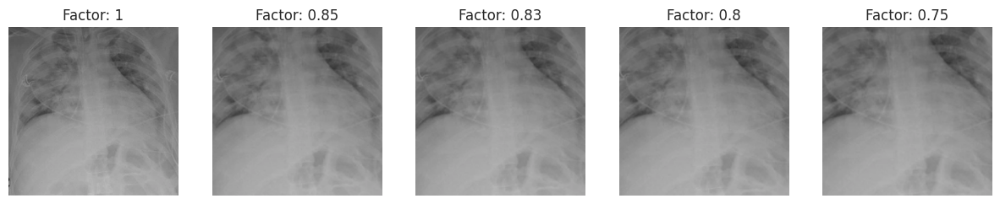

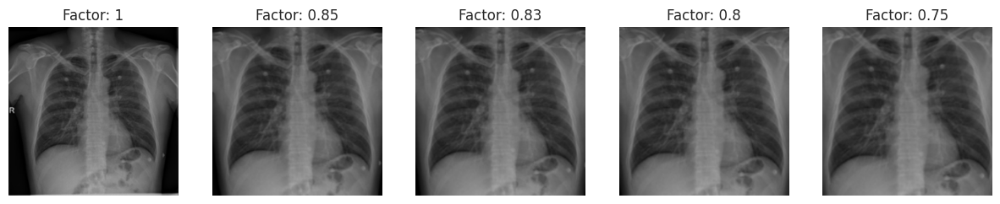

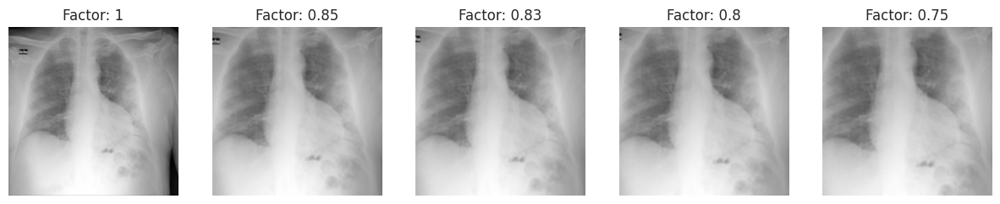

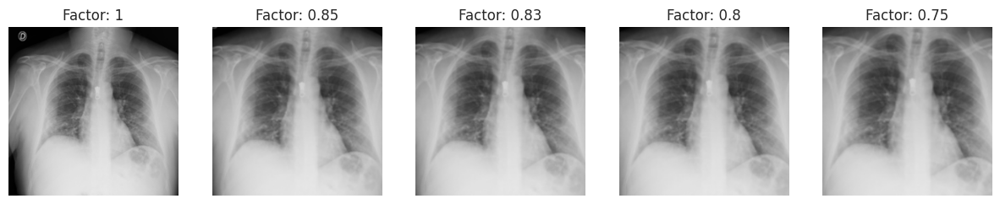

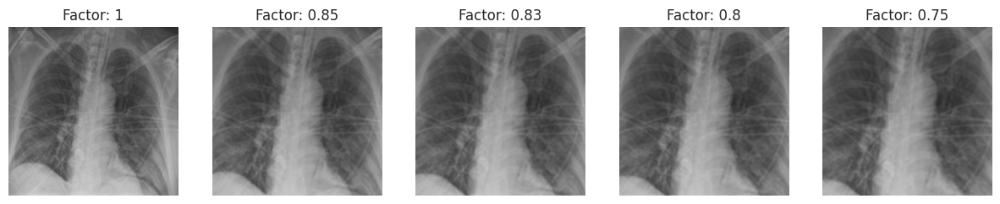

...

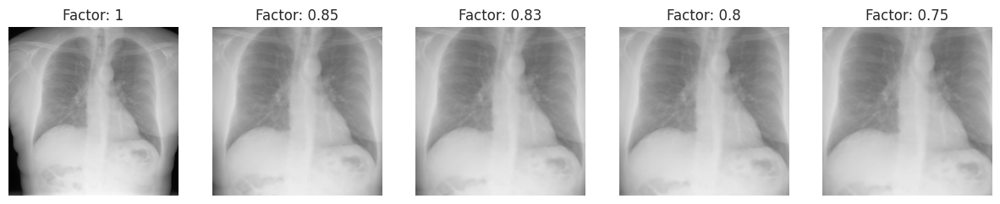

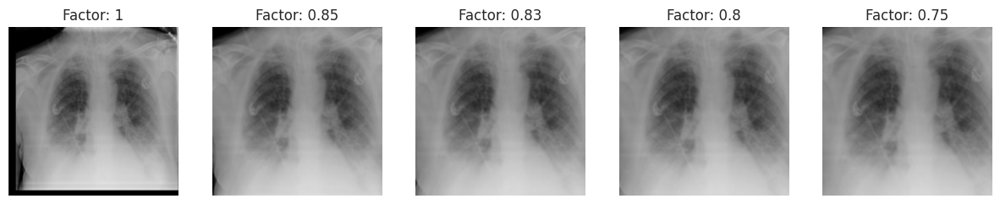

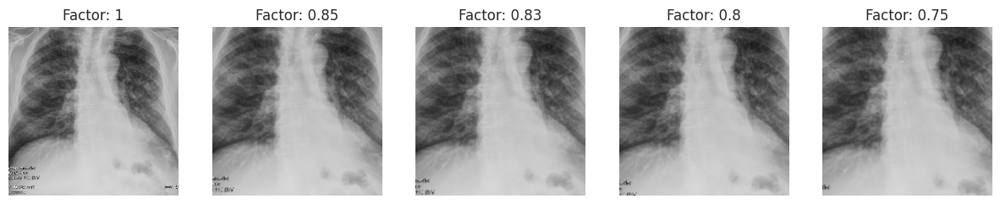

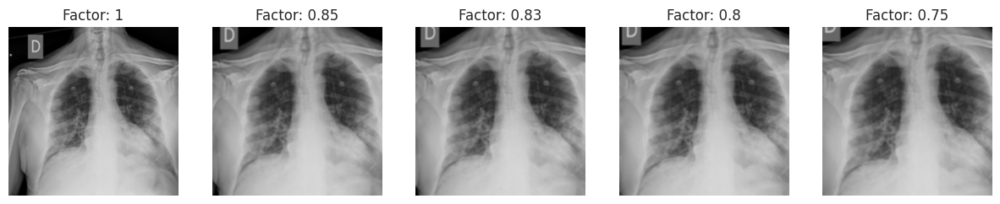

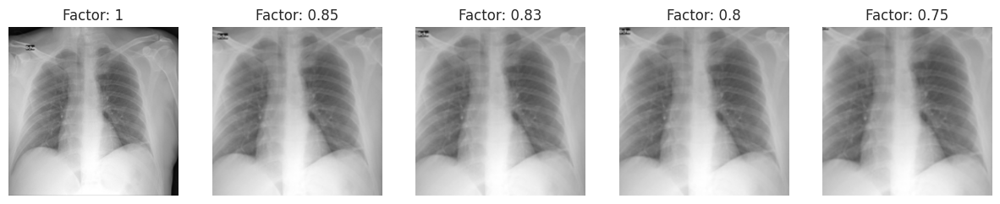

In [ ]:
visualize(train_dataset, [1, 0.85, 0.83, 0.8, 0.75], zoom_into_chest_area, "Zoom Visualization")

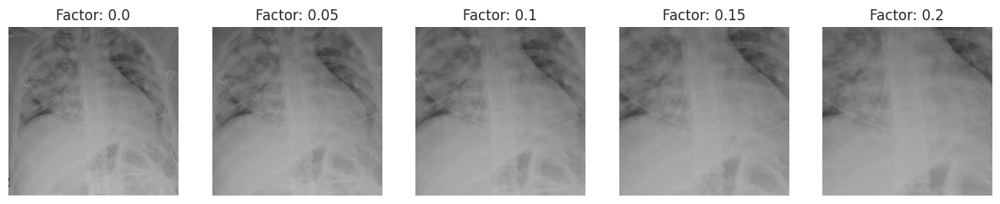

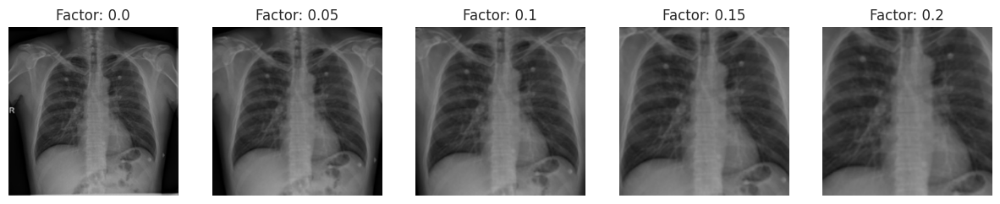

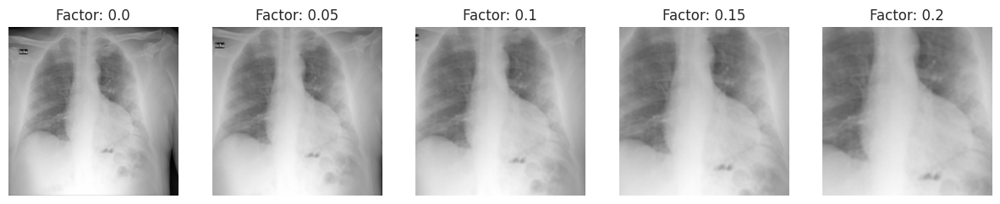

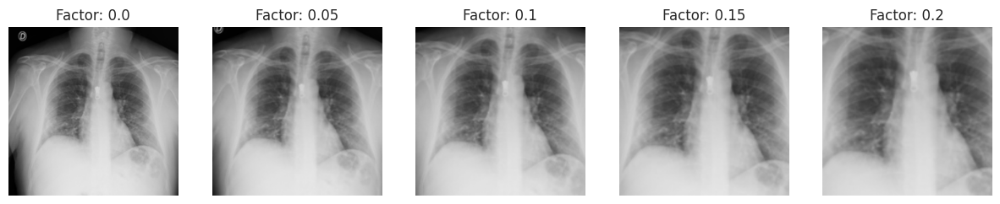

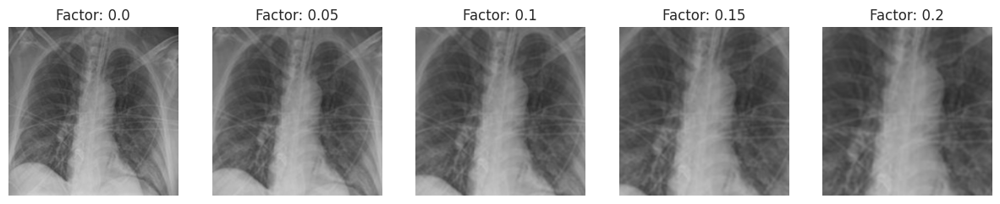

...

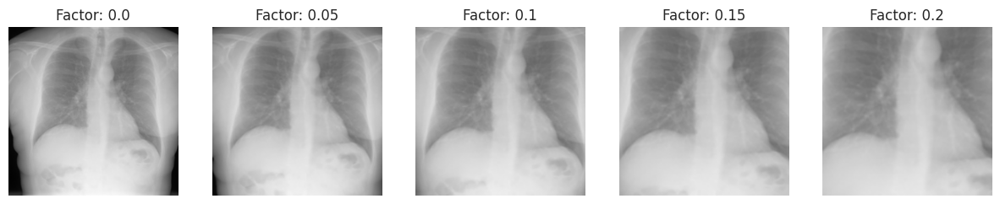

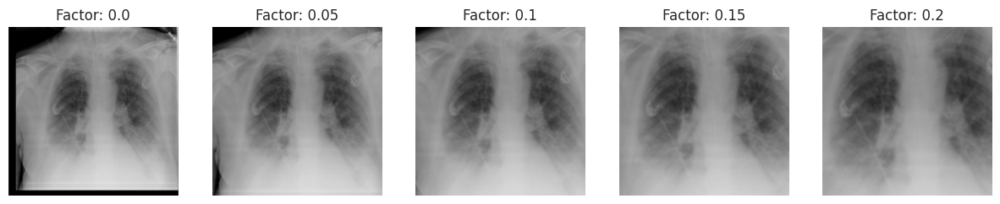

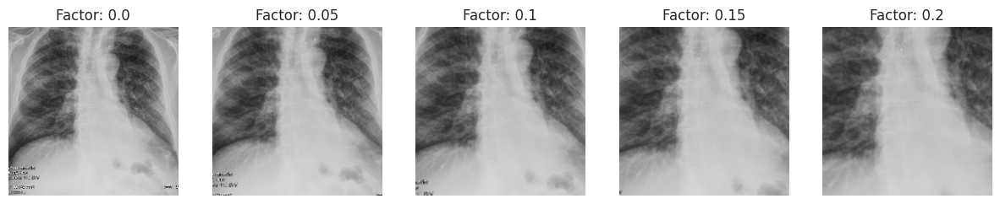

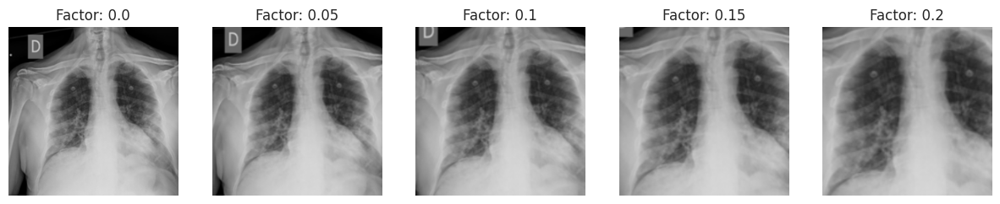

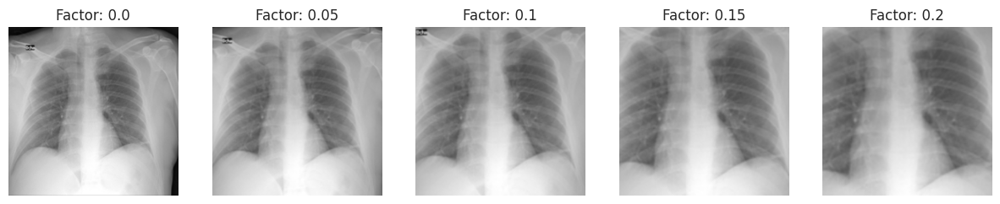

In [ ]:
visualize(train_dataset, [0.0, 0.05 , 0.1, 0.15, 0.2], crop_and_resize_image_np, "Zoom Visualization")

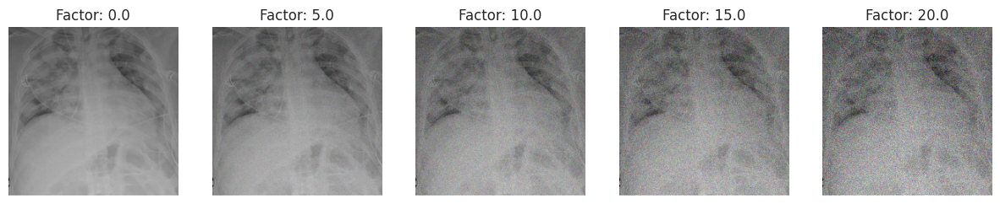

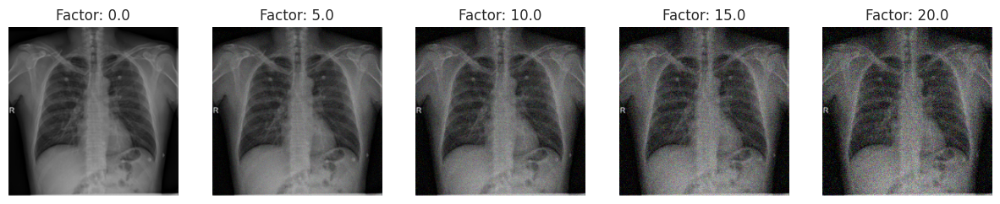

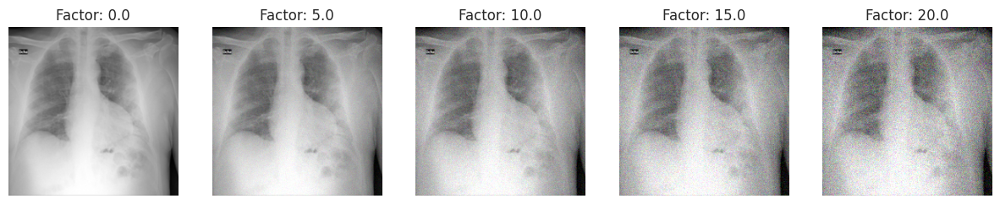

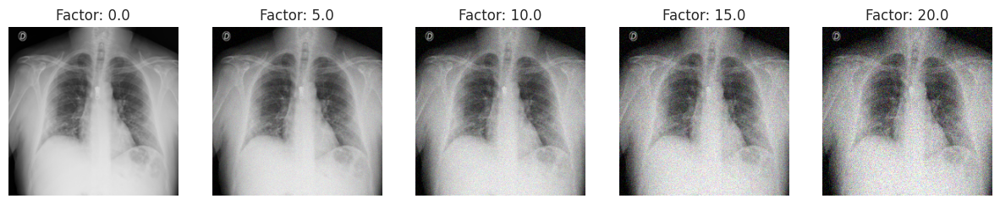

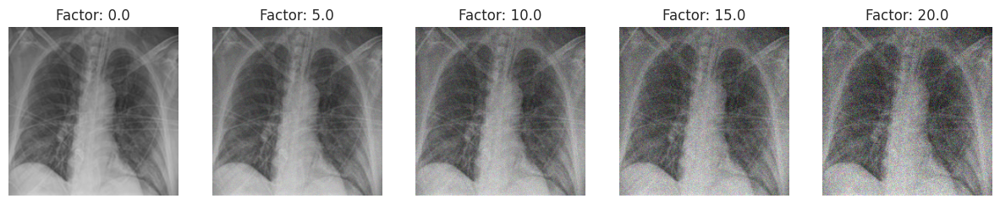

...

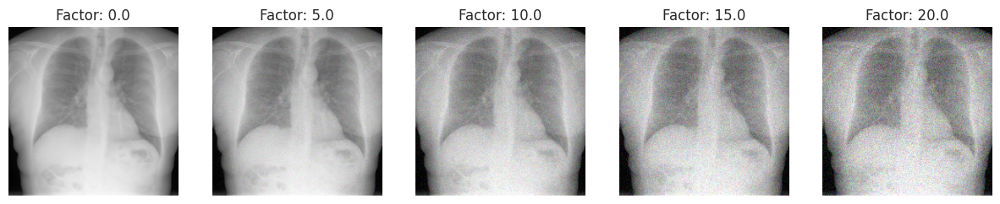

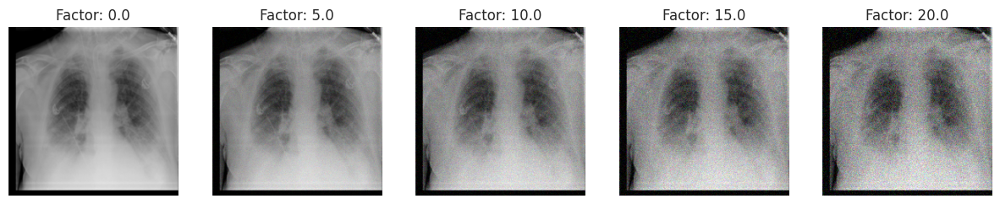

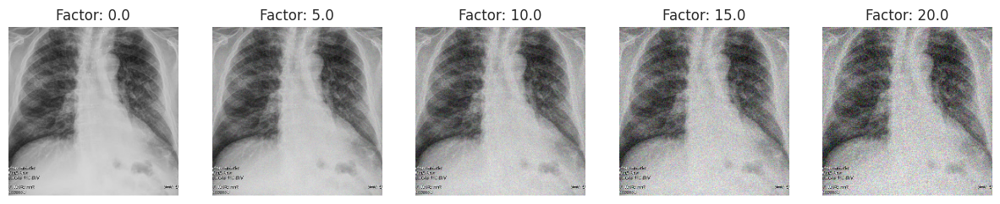

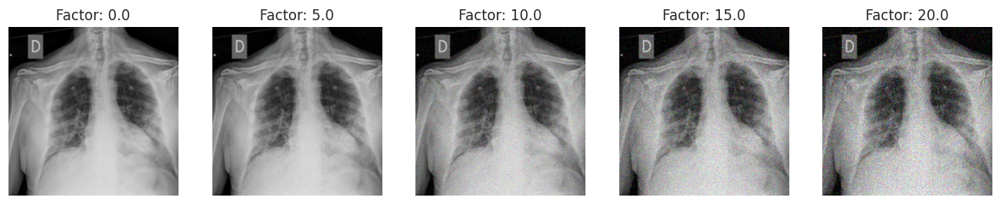

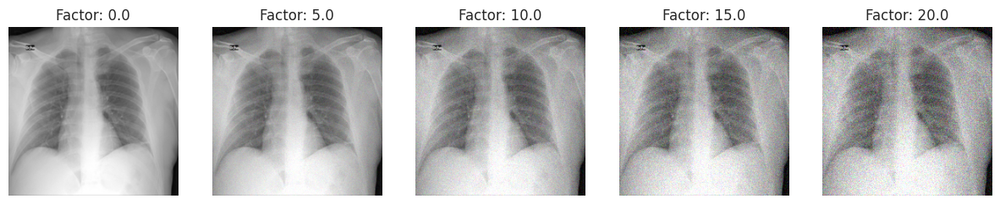

In [ ]:
visualize(train_dataset, [0.0, 5.0 , 10.0, 15.0, 20.0], add_noise_np, "Adding Noise")

In [ ]:
with tf.device('/cpu:0'):
    # Training set Pre-Processing
    train_dataset_preprocessed = train_dataset.map(preprocess_images, num_parallel_calls=tf.data.experimental.AUTOTUNE)
    # Validation set Pre-Processing
    val_dataset_preprocessed = val_dataset.map(preprocess_images, num_parallel_calls=tf.data.experimental.AUTOTUNE)
    # Testing set Pre-Processing
    test_dataset_preprocessed = test_dataset.map(preprocess_images, num_parallel_calls=tf.data.experimental.AUTOTUNE)

In [ ]:
def count_elements_in_dataset(dataset):
    count = 0
    for _ , _ in dataset:
        count += 1
    return count

print(count_elements_in_dataset(train_dataset_preprocessed))
print(count_elements_in_dataset(val_dataset_preprocessed))
print(count_elements_in_dataset(test_dataset_preprocessed))

19610
6534
6540


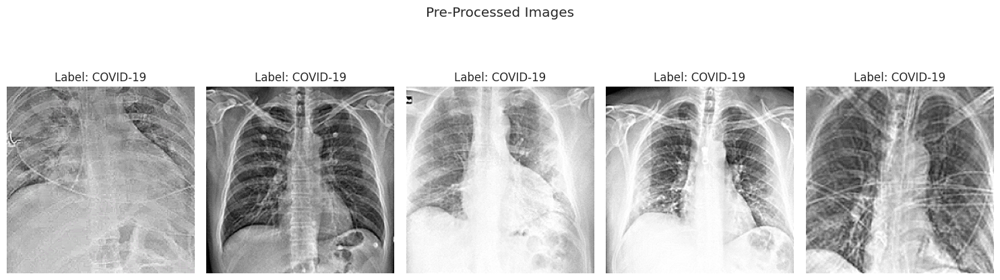

In [ ]:
visualize_dataset(train_dataset_preprocessed, "Pre-Processed Images", f"{pre_processing}PreProcessed_Image_Final.png")

In [ ]:
test_ds(train_dataset_preprocessed, 1)

(224, 224, 3) (1,)
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


(224, 224, 3) (1,)
0 255 166.54162016369048
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


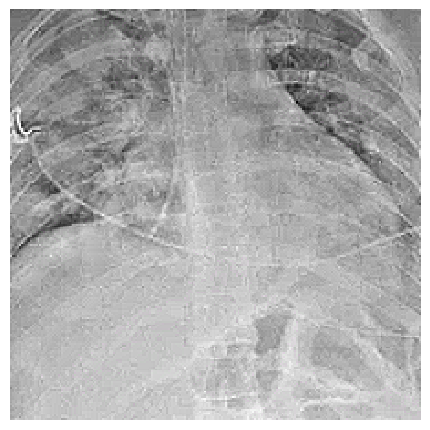

(224, 224, 3) (1,)
0 255 122.89231903698979
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


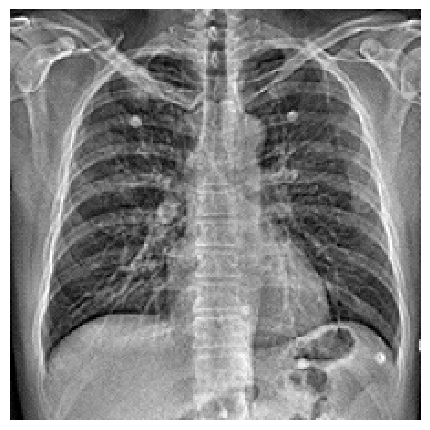

(224, 224, 3) (1,)
0 255 210.38811383928572
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


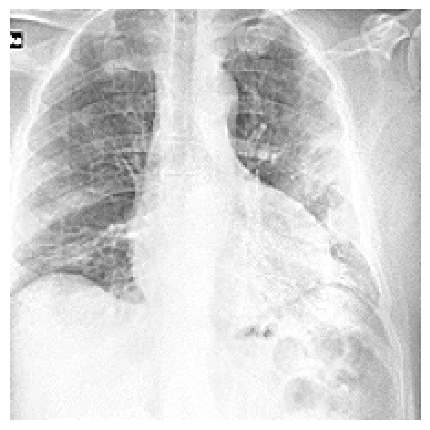

(224, 224, 3) (1,)
0 255 197.1524433992347
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


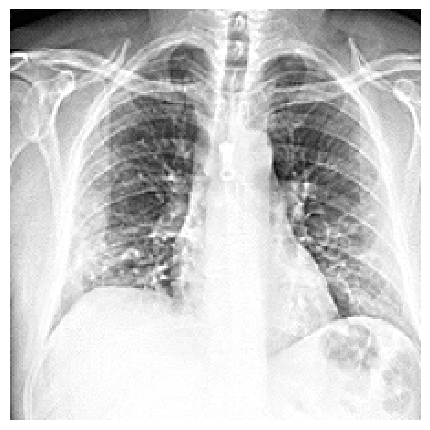

(224, 224, 3) (1,)
20 255 148.77572943239795
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


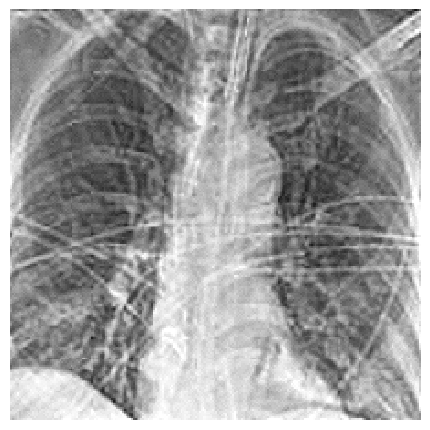

(224, 224, 3) (1,)
0 255 206.03519610969389
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


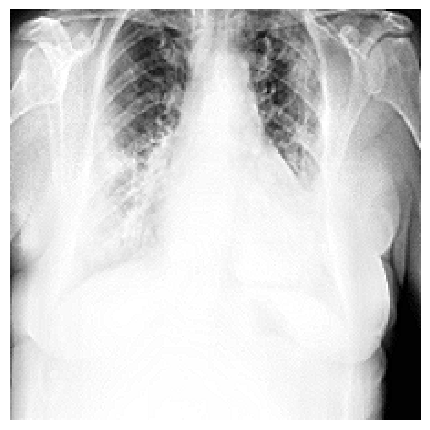

(224, 224, 3) (1,)
0 255 143.74412069515307
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


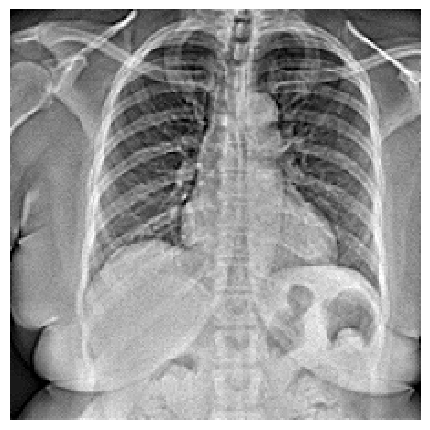

(224, 224, 3) (1,)
0 255 170.12719228316325
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


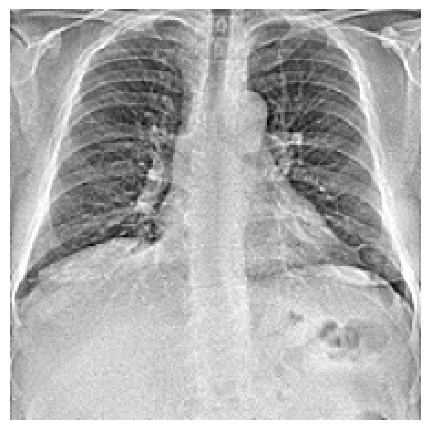

(224, 224, 3) (1,)
0 255 181.78790656887756
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


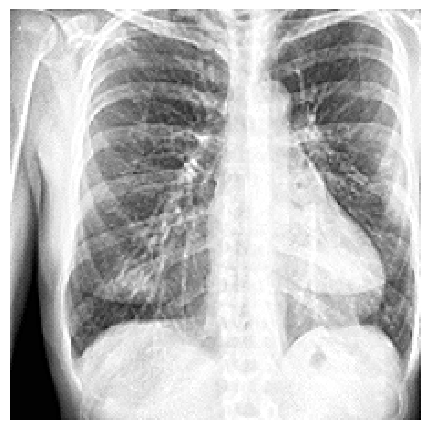

(224, 224, 3) (1,)
20 255 209.19714604591837
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


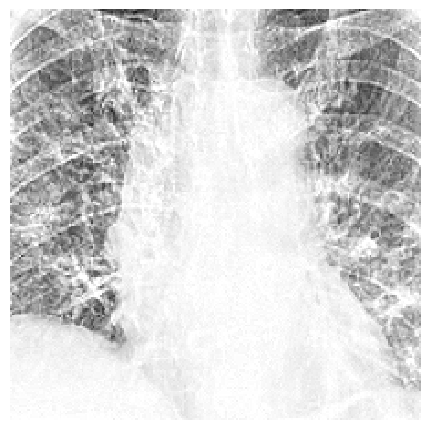

In [ ]:
test_ds_plot(train_dataset_preprocessed, 10)

(224, 224, 3) (1,)
0 255 195.1288464604592
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


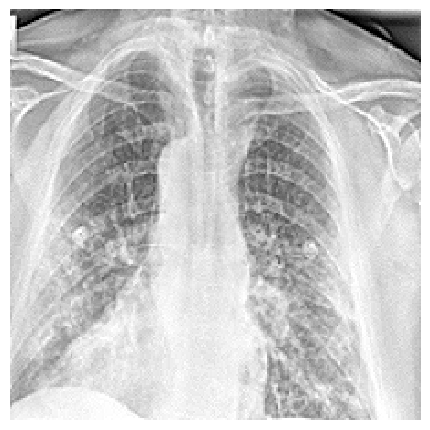

(224, 224, 3) (1,)
1 255 159.84187659438774
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


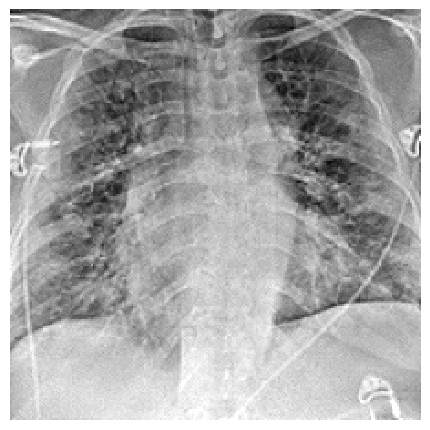

(224, 224, 3) (1,)
0 255 164.68941326530611
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


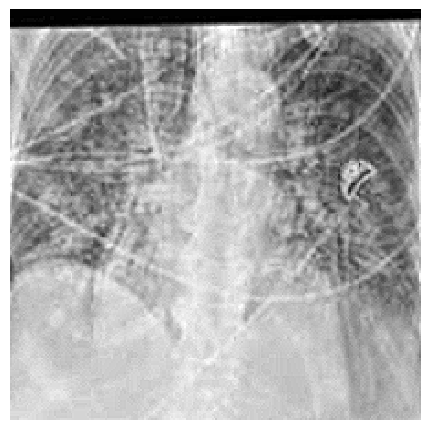

(224, 224, 3) (1,)
0 255 195.26975047831633
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


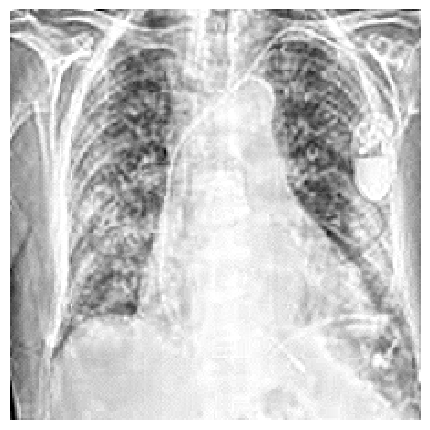

(224, 224, 3) (1,)
10 255 197.03918207908163
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


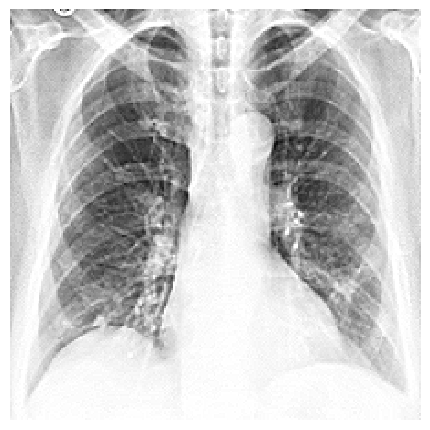

(224, 224, 3) (1,)
0 255 193.02309869260205
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


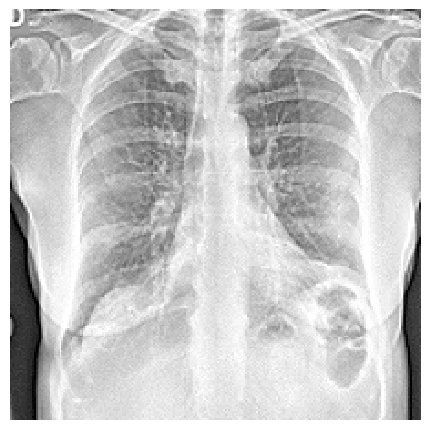

(224, 224, 3) (1,)
0 255 200.47865513392858
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


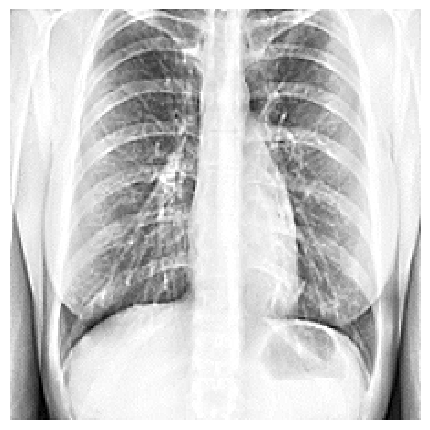

(224, 224, 3) (1,)
0 255 206.8713528380102
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


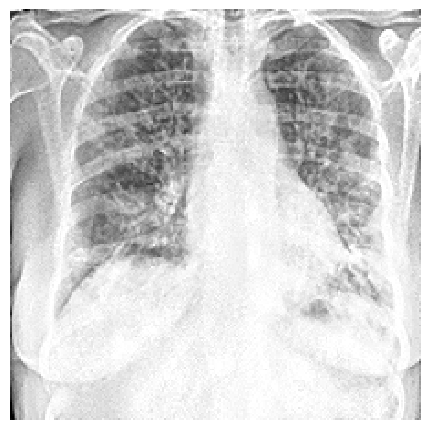

(224, 224, 3) (1,)
0 255 182.9842753507653
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


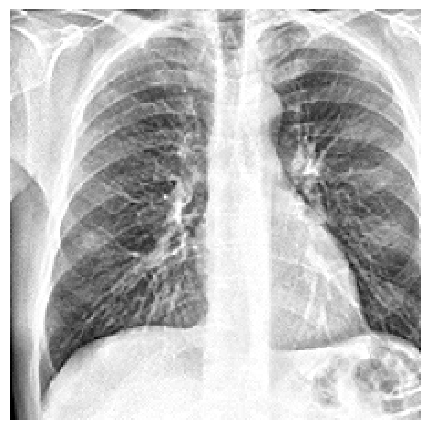

(224, 224, 3) (1,)
17 255 175.4845742984694
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


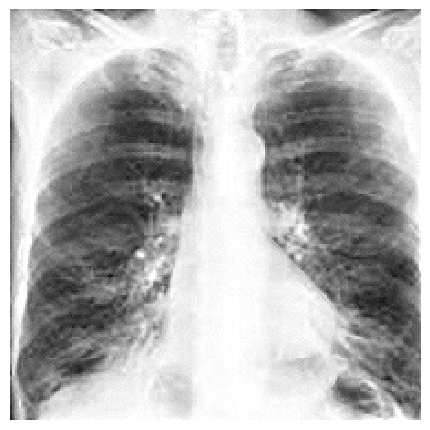

In [ ]:
test_ds_plot(val_dataset_preprocessed, 10)

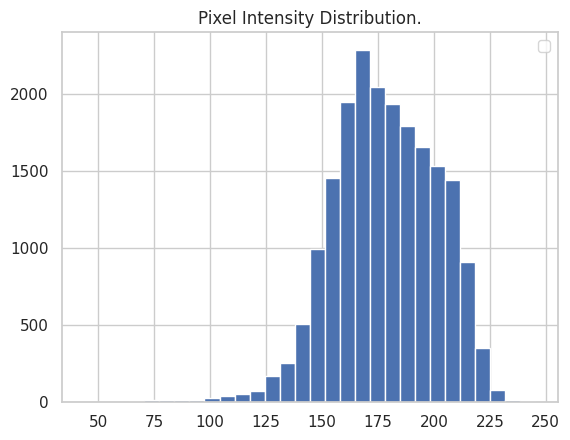

In [ ]:
plot_pixel_intensity_from_dataset(train_dataset_preprocessed)

In [ ]:
test_ds(train_dataset_preprocessed, 1)

(224, 224, 3) (1,)
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


In [ ]:
Seed = 123
Batch_Size = 128
Image_Size = 224
num_classes = 5
BUFFER_SIZE = 19610
np.random.seed(Seed)
tf.random.set_seed(Seed)

In [ ]:
"""
1. ResNet50 Pre Process
"""
# Scaling
def scaling(image, label):
    image = tf.cast(image, tf.float32) / 255.0
    return image, label

In [ ]:
with tf.device('/cpu:0'):
    train_dataset_scaled = train_dataset_preprocessed.map(lambda img, lbl: scaling(img,lbl), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    val_dataset_scaled = val_dataset_preprocessed.map(lambda img, lbl: scaling(img,lbl), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    test_dataset_scaled = test_dataset_preprocessed.map(lambda img, lbl: scaling(img,lbl), num_parallel_calls=tf.data.experimental.AUTOTUNE)

In [ ]:
test_ds(train_dataset_scaled, 1)

(224, 224, 3) (1,)
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


In [ ]:
# Zero Centering
with tf.device('/cpu:0'):

    def accumulate_images(img, label):
        return tf.reduce_sum(img, axis=0), tf.shape(img)[0]

    # Map the accumulate function onto the dataset and reduce to get global sum and count
    accumulated_data = train_dataset_scaled.map(accumulate_images).reduce(
        (tf.zeros([224, 224, 3]), 0),
        lambda x, y: (x[0] + y[0], x[1] + y[1])
    )

    # Compute the mean
    mean_image = accumulated_data[0] / tf.cast(accumulated_data[1], tf.float32)


In [ ]:
# Zero-centering
def zero_center(image, label):
    return image - mean_image, label

with tf.device('/cpu:0'):
      # Apply zero-centering to the datasets
      train_dataset_scaled_centered = train_dataset_scaled.map(zero_center, num_parallel_calls=tf.data.experimental.AUTOTUNE)
      val_dataset_scaled_centered = val_dataset_scaled.map(zero_center, num_parallel_calls=tf.data.experimental.AUTOTUNE)
      test_dataset_scaled_centered = test_dataset_scaled.map(zero_center, num_parallel_calls=tf.data.experimental.AUTOTUNE)


In [ ]:
test_ds(train_dataset_scaled_centered, 1)

(224, 224, 3) (1,)
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


In [ ]:
print(f"Buffer Size : {BUFFER_SIZE}")

# train_dataset_normalized = train_dataset_normalized.shuffle(BUFFER_SIZE)
train_dataset_scaled_centered = train_dataset_scaled_centered.shuffle(4096)
# test_dataset_scaled_centered = test_dataset_scaled_centered.shuffle(2048)
val_dataset_scaled_centered = val_dataset_scaled_centered.shuffle(2048)

Buffer Size : 19610


In [ ]:
test_ds(train_dataset_scaled_centered, 1)

(224, 224, 3) (1,)
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


In [ ]:
num_classes = 5

def one_hot_encode_batched(images, labels):
    labels = tf.cast(labels, tf.int32)
    labels = tf.one_hot(labels, depth=num_classes)
    labels = tf.squeeze(labels, axis = 1)  # Remove unnecessary dimensions
    return images, labels

In [ ]:
# Scaled , 0 centered dataset Batch and Prefetch
train_dataset_scaled_centered_batched_onehot = (train_dataset_scaled_centered
                                                # .shuffle(BUFFER_SIZE)
                                                .batch(Batch_Size)
                                                .map(one_hot_encode_batched, num_parallel_calls=tf.data.experimental.AUTOTUNE)
                                                # .shuffle(BUFFER_SIZE//Batch_Size)
                                                .prefetch(tf.data.experimental.AUTOTUNE))

val_dataset_scaled_centered_batched_onehot = (val_dataset_scaled_centered
                                              # .shuffle(BUFFER_SIZE)
                                              .batch(Batch_Size)
                                              .map(one_hot_encode_batched, num_parallel_calls=tf.data.experimental.AUTOTUNE)
                                              # .shuffle(BUFFER_SIZE//Batch_Size)
                                              .prefetch(tf.data.experimental.AUTOTUNE))

test_dataset_scaled_centered_batched_onehot = (test_dataset_scaled_centered
                                                # .shuffle(BUFFER_SIZE)
                                                .batch(Batch_Size)
                                                .map(one_hot_encode_batched, num_parallel_calls=tf.data.experimental.AUTOTUNE)
                                                # .shuffle(BUFFER_SIZE//Batch_Size)
                                                .prefetch(tf.data.experimental.AUTOTUNE))

In [ ]:
def count_images_in_batched_dataset(dataset):
    count = 0
    for batch in dataset:
        count += batch[0].shape[0]  # Assuming batch is a tuple of (images, labels)
    return count

print(count_images_in_batched_dataset(train_dataset_scaled_centered_batched_onehot))
print(count_images_in_batched_dataset(val_dataset_scaled_centered_batched_onehot))
print(count_images_in_batched_dataset(test_dataset_scaled_centered_batched_onehot))

19610
6534
6540


In [ ]:
test_ds(train_dataset_scaled_centered_batched_onehot, 1)

test_ds(test_dataset_scaled_centered_batched_onehot, 1)

test_ds(val_dataset_scaled_centered_batched_onehot, 1)

(128, 224, 224, 3) (128, 5)
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>
(128, 224, 224, 3) (128, 5)
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>
(128, 224, 224, 3) (128, 5)
<class 'tensorflow.python.framework.ops.EagerTensor'> <class 'tensorflow.python.framework.ops.EagerTensor'>


In [ ]:
def plot_batch_class_distribution(dataset, num_batches):
    """
    Plots class distribution across batches of a dataset.

    Args:
    - dataset: tf.data.Dataset containing batches of (images, labels).
    - num_batches: Number of batches to consider from the dataset.
    """
    def one_hot_to_class(one_hot_labels):
        return np.argmax(one_hot_labels, axis=-1)

    batch_distributions = []

    # Iterate through batches
    for _, labels in dataset.take(num_batches):
        labels_class = one_hot_to_class(labels.numpy())
        batch_distribution = np.bincount(labels_class, minlength=5)  # Assuming 5 classes, adjust if different
        batch_distributions.append(batch_distribution)

    # Convert to numpy array for easier indexing
    batch_distributions = np.array(batch_distributions)

    # Plotting
    fig, ax = plt.subplots(figsize=(15, 5))
    for class_idx in range(5):  # Assuming 5 classes
        ax.bar(np.arange(len(batch_distributions)), batch_distributions[:, class_idx],
               bottom=np.sum(batch_distributions[:, :class_idx], axis=1), label=f'Class {class_idx}')

    ax.set_xlabel('Batch Number')
    ax.set_ylabel('Count')
    ax.set_title('Class Distribution Across Batches')
    ax.legend()
    plt.show()

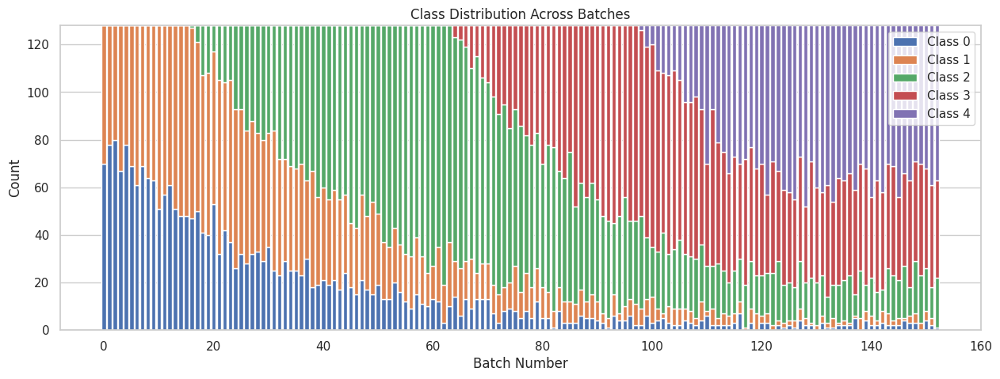

In [ ]:
batch_distributions = []
num_batches = BUFFER_SIZE // Batch_Size
plot_batch_class_distribution(train_dataset_scaled_centered_batched_onehot, num_batches)

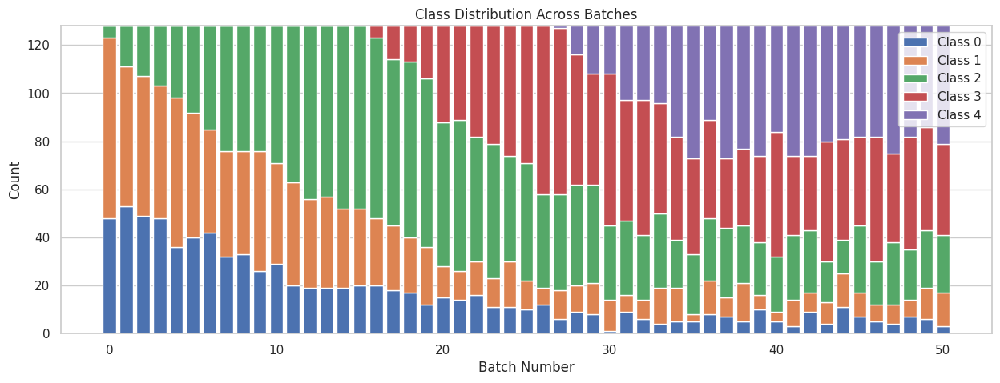

In [ ]:
batch_distributions = []
num_batches = 6534 // Batch_Size
plot_batch_class_distribution(val_dataset_scaled_centered_batched_onehot, num_batches)

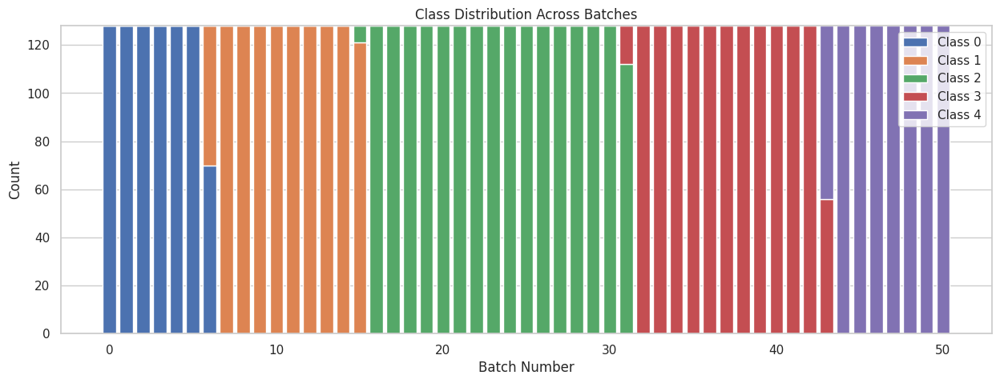

In [ ]:
batch_distributions = []
num_batches = 6540 // Batch_Size
plot_batch_class_distribution(test_dataset_scaled_centered_batched_onehot, num_batches)

In [ ]:
def Confusion_Matrix_Heatmap(y_test,y_pred,class_Names, fName, ModelName):
    #Plot the confusion matrix to understand the classification in detail
    CM = confusion_matrix(y_test, y_pred)
    plt.figure(figsize=(10, 8), dpi=80, facecolor='w', edgecolor='k')
    ax = sns.heatmap(CM, cmap='Greens', annot=True, fmt='d', xticklabels=class_Names, yticklabels=class_Names)
    plt.title(f'Disease Diagnosis from CXR images - {ModelName}')
    plt.xlabel('Prediction')
    plt.ylabel('Truth')
    plt.savefig(f"{resnet50}{fName}")
    #plt.show(ax)

# Plot Evaluation Metrics
# sns.set_style('darkgrid')
#plt.style.use('fivethirtyeight')
def Eval_Plot(acc,val_acc, loss,val_loss, auc, val_auc, precision, val_precision, path, title):

    fig, (ax1,ax2,ax3,ax4) = plt.subplots(1,4, figsize= (20,5))
    fig.suptitle(f"{title}\n", fontsize = 15)

    ax1.plot(range(1, len(acc) + 1), acc)
    ax1.plot(range(1, len(val_acc) + 1), val_acc)
    ax1.set_title('History of Accuracy', fontsize = 15)
    ax1.set_xlabel('Epochs', fontsize = 15)
    ax1.set_ylabel('Accuracy', fontsize = 15)
    ax1.legend(['Training', 'Validation'], fontsize = 15)


    ax2.plot(range(1, len(loss) + 1), loss)
    ax2.plot(range(1, len(val_loss) + 1), val_loss)
    ax2.set_title('History of Loss', fontsize = 15)
    ax2.set_xlabel('Epochs', fontsize = 15)
    ax2.set_ylabel('Loss', fontsize = 15)
    ax2.legend(['Training', 'Validation'], fontsize = 15)

    ax3.plot(range(1, len(auc) + 1), auc)
    ax3.plot(range(1, len(val_auc) + 1), val_auc)
    ax3.set_title('History of AUC', fontsize = 15)
    ax3.set_xlabel('Epochs', fontsize = 15)
    ax3.set_ylabel('AUC', fontsize = 15)
    ax3.legend(['Training', 'Validation'], fontsize = 15)

    ax4.plot(range(1, len(precision) + 1), precision)
    ax4.plot(range(1, len(val_precision) + 1), val_precision)
    ax4.set_title('History of Precision', fontsize = 15)
    ax4.set_xlabel('Epochs', fontsize = 15)
    ax4.set_ylabel('Precision', fontsize = 15)
    ax4.legend(['Training', 'Validation'], fontsize = 15)

    plt.savefig(f"{resnet50}{path}")
    plt.show()

In [ ]:
# GCW : Global Class Based Weighting
total_samples = 2512 + 3607 + 6115 + 4438 + 2938
num_classes = 5 # Assuming there are 5 classes based on the weight calculation

# Define ClassName_Dict_Label
ClassName_Dict_Label = {
    'COVID-19': 0,
    'Lung-Opacity': 1,
    'Normal': 2,
    'Viral Pneumonia': 3,
    'Tuberculosis': 4
}

# Calculate the global class-based weights
weights = {
    'COVID-19':  total_samples / (num_classes * 2512),
    'Lung-Opacity':  total_samples / (num_classes * 3607),
    'Normal':  total_samples / (num_classes * 6115),
    'Viral Pneumonia':  total_samples / (num_classes * 4438),
    'Tuberculosis':  total_samples / (num_classes * 2938)
}

int_weights = {ClassName_Dict_Label[key]: value for key, value in weights.items()}
print(int_weights)

{0: 1.5613057324840764, 1: 1.0873301912947047, 2: 0.6413736713000817, 3: 0.8837314105452907, 4: 1.334921715452689}


In [ ]:
steps_per_epoch = total_samples // Batch_Size
print('steps per epoch: ',steps_per_epoch + 1)

steps per epoch:  154


In [ ]:
import h5py

# Load labels from HDF5 files (adjust paths as needed)
with h5py.File('/content/drive/MyDrive/Medical Data/Dataset5_raw_train.h5', 'r') as f:
    train_labels = np.array(f['image_label'])  # Replace 'image_label' with the correct dataset name

with h5py.File('/content/drive/MyDrive/Medical Data/Dataset5_raw_val.h5', 'r') as f:
    val_labels = np.array(f['image_label'])  # Replace 'image_label' with the correct dataset name

with h5py.File('/content/drive/MyDrive/Medical Data/Dataset5_raw_test.h5', 'r') as f:
    test_labels = np.array(f['image_label'])  # Replace 'image_label' with the correct dataset name

# Verify the labels are loaded
print("Sample train labels:", train_labels[:10])
print("Sample val labels:", val_labels[:10])
print("Sample test labels:", test_labels[:10])


Sample train labels: [[0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]]
Sample val labels: [[0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]]
Sample test labels: [[0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]
 [0.]]


In [ ]:
from sklearn.preprocessing import LabelEncoder

# Initialize the encoder
label_encoder = LabelEncoder()

# Fit the encoder on all labels and transform each set
train_labels_int = label_encoder.fit_transform(train_labels)
val_labels_int = label_encoder.transform(val_labels)
test_labels_int = label_encoder.transform(test_labels)

# Check the label encoding
print("Classes:", label_encoder.classes_)
print("Encoded train labels:", train_labels_int[:10])


Classes: [0. 1. 2. 3. 4.]
Encoded train labels: [0 0 0 0 0 0 0 0 0 0]


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_label.py:114: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_label.py:132: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, dtype=self.classes_.dtype, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_label.py:132: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, dtype=self.classes_.dtype, warn=True)


In [ ]:
from tensorflow.keras.utils import to_categorical

# One-hot encode the labels
train_labels_one_hot = to_categorical(train_labels_int)
val_labels_one_hot = to_categorical(val_labels_int)
test_labels_one_hot = to_categorical(test_labels_int)

# Check the shape to confirm one-hot encoding
print("One-hot encoded train labels shape:", train_labels_one_hot.shape)
print("One-hot encoded val labels shape:", val_labels_one_hot.shape)
print("One-hot encoded test labels shape:", test_labels_one_hot.shape)


One-hot encoded train labels shape: (19610, 5)
One-hot encoded val labels shape: (6534, 5)
One-hot encoded test labels shape: (6540, 5)


In [ ]:
import h5py
import numpy as np

# Load training images and sequences from the HDF5 file
with h5py.File('/content/drive/MyDrive/Medical Data/Dataset5_raw_train.h5', 'r') as f:
    train_images = np.array(f['image'])        # Replace 'image' with the correct dataset name for images
    train_sequences = np.array(f['image_label'])  # Replace 'sequence' with the correct dataset name for sequences

# Load validation images and sequences
with h5py.File('/content/drive/MyDrive/Medical Data/Dataset5_raw_val.h5', 'r') as f:
    val_images = np.array(f['image'])
    val_sequences = np.array(f['image_label'])

# Load test images and sequences (optional for final evaluation)
with h5py.File('/content/drive/MyDrive/Medical Data/Dataset5_raw_test.h5', 'r') as f:
    test_images = np.array(f['image'])
    test_sequences = np.array(f['image_label'])

# Verify shapes
print("Train images shape:", train_images.shape)
print("Train sequences shape:", train_sequences.shape)
print("Validation images shape:", val_images.shape)
print("Validation sequences shape:", val_sequences.shape)


Train images shape: (19610, 224, 224, 3)
Train sequences shape: (19610, 1)
Validation images shape: (6534, 224, 224, 3)
Validation sequences shape: (6534, 1)


In [ ]:
# # Step 4: Combine CNN and LSTM to create hybrid model
# def create_hybrid_model(cnn_shape, lstm_shape, num_classes):
#     cnn_model = create_cnn(cnn_shape)
#     lstm_model = create_lstm(lstm_shape)

#     # Concatenate CNN and LSTM outputs
#     combined = concatenate([cnn_model.output, lstm_model.output])
#     x = Dense(128, activation='relu')(combined)
#     x = Dropout(0.5)(x)

#     # Update output layer for multi-class classification
#     output = Dense(num_classes, activation='softmax')(x)  # Use 'softmax' for multi-class

#     # Create model
#     model = Model(inputs=[cnn_model.input, lstm_model.input], outputs=output)
#     return model


In [ ]:
# # Set the number of classes
# num_classes = 5  # Adjust this to match your actual number of classes

# # Create and compile the model
# model = create_hybrid_model((224, 224, 3), (100, 1), num_classes)
# model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# # Train the model
# history = model.fit(
#     [train_images, train_sequences], train_labels_one_hot,
#     epochs=5, batch_size=32,
#     validation_data=([val_images, val_sequences], val_labels_one_hot)
# )


Epoch 1/5
613/613 [==============================] - 290s 466ms/step - loss: 1.6767 - accuracy: 0.8080 - val_loss: 0.0040 - val_accuracy: 0.9994
Epoch 2/5
613/613 [==============================] - 272s 444ms/step - loss: 0.0443 - accuracy: 0.9859 - val_loss: 2.4897e-04 - val_accuracy: 1.0000
Epoch 3/5
613/613 [==============================] - 272s 444ms/step - loss: 0.0189 - accuracy: 0.9937 - val_loss: 3.5058e-04 - val_accuracy: 0.9998
Epoch 4/5
613/613 [==============================] - 273s 445ms/step - loss: 0.0109 - accuracy: 0.9968 - val_loss: 1.0259e-05 - val_accuracy: 1.0000
Epoch 5/5
613/613 [==============================] - 269s 438ms/step - loss: 0.0113 - accuracy: 0.9967 - val_loss: 8.6956e-06 - val_accuracy: 1.0000


In [ ]:
# test_loss, test_accuracy = model.evaluate([test_images, test_sequences], test_labels_one_hot)
# print(f"Test Loss: {test_loss}")
# print(f"Test Accuracy: {test_accuracy}")


205/205 [==============================] - 17s 83ms/step - loss: 7.3655e-06 - accuracy: 1.0000
Test Loss: 7.3654900916153565e-06
Test Accuracy: 1.0


In [ ]:
# from sklearn.metrics import classification_report
# import numpy as np

# # Step 1: Get model predictions on the test set
# test_predictions = model.predict([test_images, test_sequences])
# predicted_classes = np.argmax(test_predictions, axis=1)  # Convert probabilities to class predictions

# # Step 2: Convert one-hot encoded labels back to class labels
# true_classes = np.argmax(test_labels_one_hot, axis=1)

# # Step 3: Generate the classification report
# # Convert label_encoder.classes_ to a list of strings
# target_names = [str(cls) for cls in label_encoder.classes_]

# report = classification_report(true_classes, predicted_classes, target_names=target_names)
# print(report)

205/205 [==============================] - 17s 82ms/step
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       838
         1.0       1.00      1.00      1.00      1203
         2.0       1.00      1.00      1.00      2039
         3.0       1.00      1.00      1.00      1480
         4.0       1.00      1.00      1.00       980

    accuracy                           1.00      6540
   macro avg       1.00      1.00      1.00      6540
weighted avg       1.00      1.00      1.00      6540



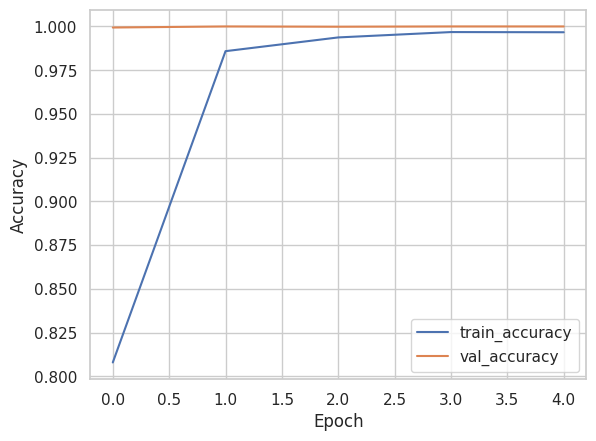

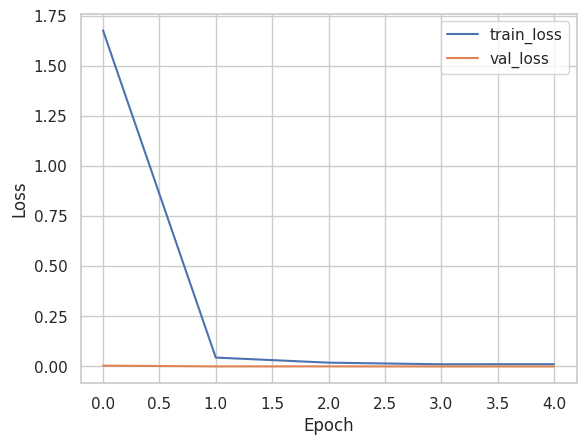

In [ ]:
# import matplotlib.pyplot as plt

# # Plot accuracy
# plt.plot(history.history['accuracy'], label='train_accuracy')
# plt.plot(history.history['val_accuracy'], label='val_accuracy')
# plt.xlabel('Epoch')
# plt.ylabel('Accuracy')
# plt.legend()
# plt.show()

# # Plot loss
# plt.plot(history.history['loss'], label='train_loss')
# plt.plot(history.history['val_loss'], label='val_loss')
# plt.xlabel('Epoch')
# plt.ylabel('Loss')
# plt.legend()
# plt.show()


The hybrid model you’re using here combines two types of neural networks: a Convolutional Neural Network (CNN) and a Long Short-Term Memory (LSTM) network. This hybrid approach leverages the strengths of each model type:

Convolutional Neural Network (CNN):

The CNN is responsible for processing image data.
It extracts spatial features from the images through convolutional and pooling layers, capturing patterns like edges, textures, and shapes.
This feature extraction from the CNN is particularly useful for image classification tasks, as it identifies visual characteristics in the data.
Long Short-Term Memory (LSTM):

The LSTM network is used to process sequential data.
It captures temporal or sequential dependencies in the data, which is essential when working with time-series data or any form of sequential data, like patient history or event sequences in medical or financial records.
Combining CNN and LSTM:

The outputs from the CNN and LSTM are concatenated to form a joint feature representation.
This combined feature vector is then passed through fully connected (dense) layers to make the final classification.
The output layer uses a softmax activation function, allowing multi-class classification across your classes.
Why This Hybrid Approach is Effective
CNN for Spatial Features: The CNN is effective at understanding spatial patterns in image data, which is valuable when distinguishing different visual classes.
LSTM for Temporal or Sequential Features: LSTM adds the ability to learn from sequential dependencies, which can be particularly powerful if the sequence order or temporal dynamics are relevant to classification.
This hybrid CNN-LSTM architecture is beneficial for scenarios where you have a combination of visual and sequential data, as it allows the model to learn both spatial and temporal patterns, leading to richer feature representations and potentially improved classification accuracy.

Why we use LSTM here?

Using an LSTM in this hybrid model can be beneficial if you have sequential or time-dependent data that provides additional context for classification. Here are key reasons for including an LSTM:

Sequential Dependencies: LSTM networks are designed to capture patterns over time or sequences. If your dataset has information that changes in a sequence (e.g., time-series data, historical records, or steps in a process), an LSTM can capture the dependencies between these steps. For example, in medical applications, patient history or time-related data may provide important insights that improve diagnostic accuracy.

Memory for Long-Term Dependencies: LSTMs have a memory mechanism that enables them to retain information from earlier parts of a sequence. This feature is particularly useful if information from earlier steps in the sequence affects the overall classification.

Complementary to CNN Features: While CNNs excel at extracting spatial features from images, they do not process sequential information. LSTMs can handle this complementary aspect, allowing the model to leverage both spatial and temporal features.

Enhanced Feature Representation: Combining spatial (CNN) and temporal (LSTM) representations often yields richer feature sets, which can lead to better classification accuracy. For instance, in disease classification, combining imaging data (such as x-rays) with temporal or sequential patient data may improve diagnosis accuracy by integrating different types of information.

Example Scenarios Where LSTM Adds Value
Medical Imaging with Patient History: If each image is paired with patient history or test results taken over time, an LSTM can capture how these values change, providing more context for the diagnosis.
Video Frame Analysis: In cases like video classification, each frame is processed as an image, and the sequence of frames is processed by the LSTM to understand motion or changes over time.
Financial or Sensor Data: In applications where image data is combined with time-series data (like sensor readings or financial data), LSTM can capture trends in the sequence that contribute to overall predictions.

In [ ]:
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D, Input, concatenate
from tensorflow.keras.models import Model

# Step 1: Define CNN for image data
def create_cnn(input_shape):
    cnn_input = Input(shape=input_shape)
    x = Conv2D(32, (3, 3), activation='relu')(cnn_input)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Conv2D(64, (3, 3), activation='relu')(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Conv2D(128, (3, 3), activation='relu')(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = Flatten()(x)
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.5)(x)
    return Model(inputs=cnn_input, outputs=x)

# Step 2: Define DNN for structured data
def create_dnn(input_shape):
    dnn_input = Input(shape=input_shape)
    x = Dense(64, activation='relu')(dnn_input)
    x = Dropout(0.5)(x)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.5)(x)
    return Model(inputs=dnn_input, outputs=x)

# Step 3: Combine CNN and DNN to create the hybrid model
def create_hybrid_model(cnn_shape, dnn_shape, num_classes):
    cnn_model = create_cnn(cnn_shape)
    dnn_model = create_dnn(dnn_shape)

    # Concatenate CNN and DNN outputs
    combined = concatenate([cnn_model.output, dnn_model.output])
    x = Dense(128, activation='relu')(combined)
    x = Dropout(0.5)(x)
    output = Dense(num_classes, activation='softmax')(x)  # Softmax for multi-class classification

    # Create model
    model = Model(inputs=[cnn_model.input, dnn_model.input], outputs=output)
    return model


In [ ]:
print("train_sequences shape:", train_sequences.shape)


train_sequences shape: (19610, 1)


In [ ]:
# Define shapes and number of classes
cnn_shape = (224, 224, 3)  # Image shape
dnn_shape = (1,)           # Structured data shape; update to match your actual shape
num_classes = 5            # Update based on your dataset

# Create and compile the model
model = create_hybrid_model(cnn_shape, dnn_shape, num_classes)
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


In [ ]:
# Train the model (update with actual data variables)
history = model.fit(
    [train_images, train_sequences], train_labels_one_hot,
    epochs=5, batch_size=32,
    validation_data=([val_images, val_sequences], val_labels_one_hot)
)

Epoch 1/5
613/613 [==============================] - 288s 466ms/step - loss: 2.1407 - accuracy: 0.6030 - val_loss: 0.3825 - val_accuracy: 0.9755
Epoch 2/5
613/613 [==============================] - 269s 440ms/step - loss: 0.3933 - accuracy: 0.8585 - val_loss: 0.0985 - val_accuracy: 0.9920
Epoch 3/5
613/613 [==============================] - 270s 440ms/step - loss: 0.2472 - accuracy: 0.9140 - val_loss: 0.0561 - val_accuracy: 0.9945
Epoch 4/5
613/613 [==============================] - 268s 438ms/step - loss: 0.1799 - accuracy: 0.9378 - val_loss: 0.0422 - val_accuracy: 0.9922
Epoch 5/5
613/613 [==============================] - 272s 444ms/step - loss: 0.1453 - accuracy: 0.9526 - val_loss: 0.0120 - val_accuracy: 0.9989


In [ ]:
from sklearn.metrics import classification_report
import numpy as np

# Step 1: Get model predictions on the test set
test_predictions = model.predict([test_images, test_sequences])  # Ensure test_images and test_sequences are defined
predicted_classes = np.argmax(test_predictions, axis=1)  # Convert probabilities to class indices

# Step 2: Convert one-hot encoded labels back to class labels
true_classes = np.argmax(test_labels_one_hot, axis=1)  # Convert one-hot encoded labels to class indices

# Step 3: Generate the classification report
# Replace `label_encoder.classes_` with actual class names if available, e.g., ["COVID-19", "Lung-Opacity", "Normal", "Viral Pneumonia", "Tuberculosis"]
class_names = ["COVID-19", "Lung-Opacity", "Normal", "Viral Pneumonia", "Tuberculosis"]
report = classification_report(true_classes, predicted_classes, target_names=class_names)
print(report)


205/205 [==============================] - 17s 83ms/step
                 precision    recall  f1-score   support

       COVID-19       1.00      1.00      1.00       838
   Lung-Opacity       1.00      1.00      1.00      1203
         Normal       1.00      1.00      1.00      2039
Viral Pneumonia       1.00      1.00      1.00      1480
   Tuberculosis       1.00      1.00      1.00       980

       accuracy                           1.00      6540
      macro avg       1.00      1.00      1.00      6540
   weighted avg       1.00      1.00      1.00      6540



In [ ]:
# Evaluate the model on the test set
test_loss, test_accuracy = model.evaluate([test_images, test_sequences], test_labels_one_hot)
print(f"Test Loss: {test_loss}")
print(f"Test Accuracy: {test_accuracy}")


205/205 [==============================] - 17s 82ms/step - loss: 0.0114 - accuracy: 0.9995
Test Loss: 0.01142028532922268
Test Accuracy: 0.9995412826538086


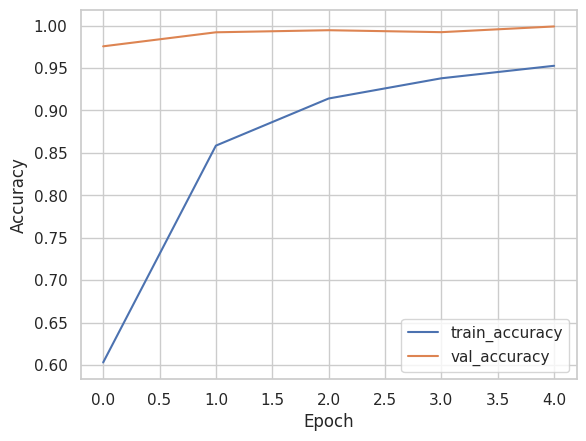

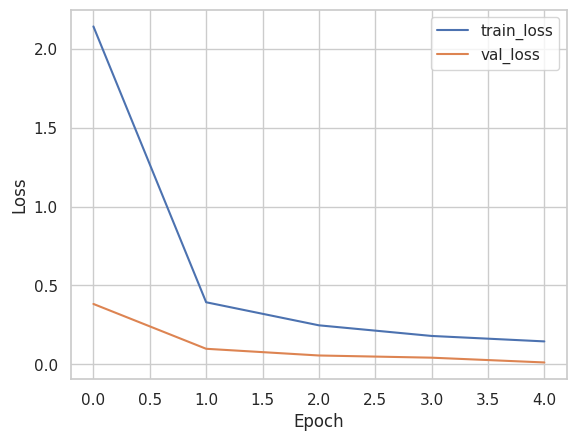

In [ ]:
import matplotlib.pyplot as plt

# Plot accuracy
plt.plot(history.history['accuracy'], label='train_accuracy')
plt.plot(history.history['val_accuracy'], label='val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

# Plot loss
plt.plot(history.history['loss'], label='train_loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

205/205 [==============================] - 18s 87ms/step


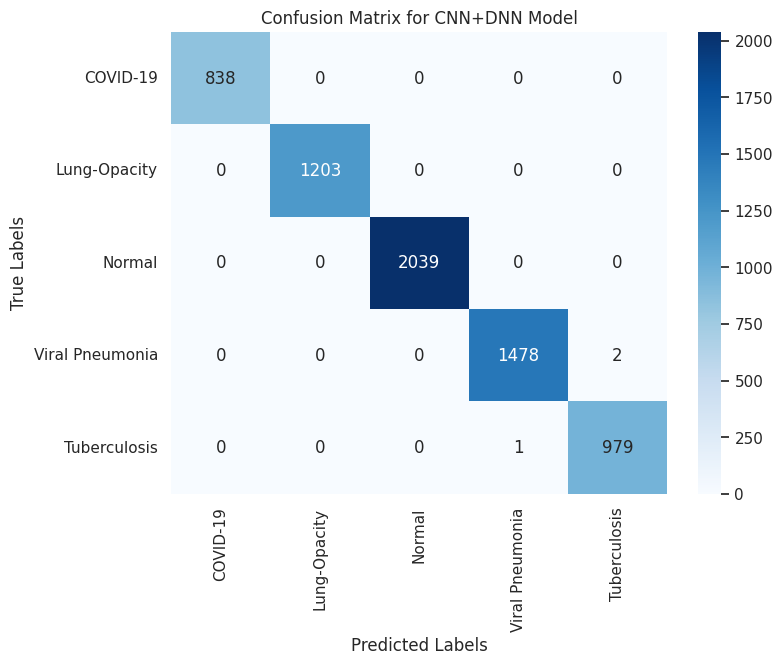

In [ ]:
from sklearn.metrics import confusion_matrix
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Step 1: Get model predictions on the test set
test_predictions = model.predict([test_images, test_sequences])  # Ensure test_images and test_sequences are defined
predicted_test_classes = np.argmax(test_predictions, axis=1)     # Convert probabilities to class indices

# Step 2: Convert one-hot encoded test labels back to class indices
true_test_classes = np.argmax(test_labels_one_hot, axis=1)       # Convert one-hot encoded labels to class indices

# Step 3: Generate the confusion matrix
conf_matrix = confusion_matrix(true_test_classes, predicted_test_classes)

# Step 4: Plot the confusion matrix
class_names = ["COVID-19", "Lung-Opacity", "Normal", "Viral Pneumonia", "Tuberculosis"]
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Confusion Matrix for CNN+DNN Model")
plt.show()


Why We Use a CNN+DNN Hybrid Model
Two Types of Data: The CNN+DNN hybrid model is powerful because it can handle both image data and structured data (like numeric or categorical data). In your case, CNN processes the images, and DNN processes the structured features.

Combining Strengths:

CNN (Convolutional Neural Network) excels at recognizing patterns in images, like shapes and textures, which helps in identifying visual details for classification.
DNN (Dense Neural Network) is good at handling structured data, learning the relationships between numeric features, or categorical data in your sequences.
Better Predictions Together: By combining CNN and DNN, the model can use information from both image patterns and structured features, leading to more accurate and informed predictions.

How We Get the Highest Accuracy
Training on Both Types of Data: Using both image and structured data enriches the model's understanding of each class, leading to more accurate predictions.

Good Preprocessing: Ensuring the images are clear and structured data is well-prepared (e.g., normalized or encoded) helps the model learn effectively.

Careful Tuning: Adjusting model hyperparameters (like the number of layers, learning rate, batch size) during training helps improve performance.

Sufficient Epochs: Training for enough epochs allows the model to learn patterns fully, but not too many to avoid overfitting.

By combining CNN and DNN, preprocessing data well, and fine-tuning the model, you can achieve high accuracy with this hybrid approach.

In [ ]:
model.save("/content/drive/MyDrive/Medical Data/CNN+DNN/cnn_dnn_hybrid_model.h5")


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
model.save("/content/drive/MyDrive/Medical Data/CNN+LTSM/cnn_lstm_hybrid_model.h5")  # Save with a unique name to distinguish it from other models


<b>How the CNN+DNN Hybrid Model Works in Your Notebook?</b><br><br>
Separate Data Streams: The hybrid model is designed to handle two types of data:

Images: Represented by train_images, val_images, and test_images.
Structured Data: Represented by train_sequences, val_sequences, and test_sequences.
CNN for Image Data:

Purpose: The CNN (Convolutional Neural Network) is responsible for processing the image data.
How It Works: Convolutional and pooling layers in the CNN extract spatial features from images, capturing visual patterns like edges, textures, and shapes. This feature extraction is important for tasks like disease classification, where specific image features may indicate different conditions.
Output: The CNN produces a feature vector that represents high-level information from the images, which is then passed to the combined layer of the model.
DNN for Structured Data:

Purpose: The DNN (Dense Neural Network) processes structured, non-image data.
How It Works: The DNN consists of fully connected (dense) layers that process each feature in the structured data (e.g., numeric or categorical features) to learn relevant patterns or relationships within this type of data.
Output: The DNN outputs a feature vector that captures information from the structured data, which is then combined with the CNN’s output.
Combining CNN and DNN Outputs:

Concatenation Layer: The outputs from the CNN and DNN branches are concatenated to form a single, combined feature vector. This step effectively merges insights from both image and structured data, creating a comprehensive feature set for the final decision-making layer.
Dense Layers for Final Classification: After concatenation, the combined feature vector is passed through additional dense layers to make the final prediction. The final output layer uses softmax activation to predict class probabilities for each possible class.
Classification:

Purpose: The softmax output layer converts the combined features into a set of probabilities, with each probability representing the model's confidence in a given class.
Outcome: The model predicts the class with the highest probability, effectively combining both visual and structured information to make a more accurate prediction.
Advantages of Using CNN+DNN in Your Notebook
Multi-Modal Data Handling: The hybrid model is powerful because it can process two types of data simultaneously—images and structured data. This is particularly useful in domains like medical diagnostics, where both types of information are important.

Enhanced Prediction Accuracy: By combining visual data and structured data, the model can capture richer information for each prediction. For instance, visual signs in an image combined with specific numeric indicators can provide more context, improving classification accuracy.

Greater Flexibility: The hybrid structure allows the model to adapt to more complex datasets, where one type of data alone might not be sufficient to capture all relevant details.



In your project, the CNN (Convolutional Neural Network) and DNN (Dense Neural Network) are combined to form a hybrid model. Here’s how each component works and how they function together to create a powerful, multi-modal model:

1. CNN (Convolutional Neural Network) for Image Data
Role: The CNN processes image data.
How It Works:
The CNN uses convolutional layers to scan over image pixels and identify spatial features, such as edges, shapes, and textures.
Pooling layers downsample the image, preserving important features while reducing complexity.
This process enables the model to learn patterns specific to images, which helps it distinguish between visual characteristics that may be unique to each class (e.g., COVID-19 versus Normal).
Output: The CNN converts the image into a feature vector—a summary of key visual patterns—which is passed to the next stage.
2. DNN (Dense Neural Network) for Structured Data
Role: The DNN processes structured data (e.g., numeric or categorical information).
How It Works:
The DNN has dense (fully connected) layers that learn from the structured data, capturing relationships between individual features.
Each layer progressively refines the data’s representation, identifying patterns or correlations within the structured features.
This can be useful for additional diagnostic information, such as patient history, test results, or other numeric features.
Output: The DNN produces a feature vector summarizing the structured data, which is then combined with the CNN’s output.
3. Combining CNN and DNN Outputs (Hybridization)
Concatenation: The outputs from the CNN and DNN are combined (concatenated) to form a single, unified feature vector.
Reason: This hybrid vector now holds both image-based and structured data-based insights, providing a richer context for making accurate predictions.
Fully Connected Layers: The combined feature vector is passed through additional dense layers for further processing and then to a softmax layer (for classification).
Final Output: The model makes a final prediction based on both visual and structured information, leveraging the strengths of each model type to improve accuracy and robustness.
Why Use CNN+DNN as a Hybrid Model?
Multi-Modal Data Processing: By combining CNN and DNN, the hybrid model can effectively handle different data types (images and structured data), making it suitable for applications where both visual and numeric/categorical features are important.
Enhanced Predictive Power: The model benefits from image features (from CNN) and additional structured data features (from DNN), which together provide a more comprehensive basis for predictions.
Improved Accuracy and Generalization: Combining insights from multiple data sources helps the model generalize better to new data and make more accurate classifications.